## Import


In [1]:
import torch
from torch import optim
import re
import numpy as np
import subprocess
import os
from scipy.optimize import least_squares

Devive Agnostic Code

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


# Get K1 and K2 (Checkerboard)

opens camera and performs camera calibration using the checkerboard.

In [3]:
# # Path to the Python script
# script_path = 'Camera-Calibration/calibration_GUI.py'

# def calibrate(camera_num): 
#     """
#     Calibrates camera(camera_num) by running the calibration_GUI script.
    
#     :param camera_num: the number of the camera. (needs to be a string)
#     :return: intrinsic matrix K
#     """
#     # Run the script and capture the output
#     output = subprocess.check_output(['python', script_path, '--cam_num', camera_num])

#     # Decode the output and process it to extract the matrix A
#     output_str = output.decode('utf-8').strip()

#     cleaned_output = output_str.replace('[', '').replace(']', '').replace(',', '').strip()

#     return cleaned_output

# # since we use a+, if we don't delete the file manually, it will write again and again.
# if os.path.exists("./output/intrinsic.txt"): 
# 	os.remove("./output/intrinsic.txt")
	
# if os.path.exists("./output/extrinsic.txt"):
# 	os.remove("./output/extrinsic.txt")

# A = np.array([list(map(float, row.split())) for row in calibrate("1").splitlines()])
# K1 = A
# A = np.array([list(map(float, row.split())) for row in calibrate("2").splitlines()])
# K2 = A

# K1[0][1] = 0 # set skew(distortion to 0)
# K2[0][1] = 0
# # Use A as needed
# print("Intrinsic Matrix K1:", K1,"\nIntrinsic Matrix K2:", K2)


# Extract K1 and K2 from txt file

for convenience, extract the intrinsics from the txt files.

In [4]:
# Read the file
with open('output/intrinsic.txt', 'r') as f:
    K = f.read()

# Extract numbers
numbers1 = re.findall(r"[-+]?\d*\.\d+|\d+", K)

# Convert to list of floats
list_K = [float(num) for num in numbers1]

# Reshape into 3x3 arrays and convert to torch tensors
K1 = torch.from_numpy(np.array(list_K[:9]).reshape(3, 3))
K2 = torch.from_numpy(np.array(list_K[9:]).reshape(3, 3))

K1 = K1.type(torch.float32).to(device)
K2 = K2.type(torch.float32).to(device)



# Set skew (distortion) to 0
# K1[0][0] , K1[1, 1]= 900, 900
# K2[0][0] , K2[1, 1]= 900, 900
# K1[0][2] , K1[1][2]= 320, 240
# K2[0][2] , K2[1][2]= 320, 240

K1[0][1] = 0 
K2[0][1] = 0

# Print out the Ks
print(f"K1: \n{K1}")
print(f"K2: \n{K2}")

K1: 
tensor([[294.6902,   0.0000, 432.7949],
        [  0.0000, 282.0225, 240.1782],
        [  0.0000,   0.0000,   1.0000]], device='cuda:0')
K2: 
tensor([[314.1694,   0.0000, 383.5623],
        [  0.0000, 299.6941, 266.9102],
        [  0.0000,   0.0000,   1.0000]], device='cuda:0')


Extract the fx, fy, u0, v0 (focal lengths and principal point from both K)

In [5]:
K1_params = [K1[0, 0], K1[1, 1], K1[0, 2], K1[1, 2]]

# Convert to tensor
K1_params = torch.stack(K1_params)

print("K1_params:", K1_params)

K2_params = [K2[0, 0], K2[1, 1], K2[0, 2], K2[1, 2]]

K2_params = torch.stack(K2_params)

print("K2_params:", K2_params)

K1_params: tensor([294.6902, 282.0225, 432.7949, 240.1782], device='cuda:0')
K2_params: tensor([314.1694, 299.6941, 383.5623, 266.9102], device='cuda:0')


# Extract matches from txt files

txt file containing the matches is called `cam_match.txt`

In [6]:
with open('data\cam_match.txt', 'r') as file:
    content = file.read()
    print(content)


match keypoints image0 [[296, 81], [424, 87], [0.95579207], [290, 72], [416, 80], [0.9400637], [289, 133], [444, 130], [0.9165063], [245, 120], [383, 131], [0.9413908], [298, 196], [463, 183], [0.8249932], [238, 184], [367, 186], [0.95982516], [314, 240], [492, 230], [0.30457017], [222, 248], [344, 239], [0.9537456], [301, 244], [443, 232], [0.93342173], [268, 247], [401, 234], [0.9616384], [298, 342], [444, 322], [0.89224917], [266, 345], [403, 326], [0.91004074], [292, 429], [448, 400], [0.9529246], [266, 446], [407, 407], [0.9308064]]"
match keypoints image1 [[296, 81], [423, 86], [0.93865657], [290, 72], [416, 80], [0.92653656], [290, 133], [445, 129], [0.939171], [246, 119], [383, 131], [0.9611505], [298, 195], [464, 183], [0.7606694], [237, 183], [367, 185], [0.95233613], [315, 240], [492, 230], [0.8924901], [220, 248], [344, 238], [0.96468675], [301, 245], [443, 231], [0.96138984], [267, 249], [400, 233], [0.9606594], [298, 344], [444, 323], [0.8990094], [266, 346], [403, 326], 

In [7]:
def extract_homonymous_pairs(content, threshold):
    """
    Extracts keypoint pairs with confidence higher than a given threshold and returns them as torch tensors.
    
    :param content: String content containing keypoints in format [x, y], [x1, y1], [confidence]
    :param threshold: Confidence threshold
    :return: Filtered coordinates as a list of torch tensors
    """
    lines = content.strip().splitlines()
    pattern = re.compile(r'\[(\d+), (\d+)\], \[(\d+), (\d+)\], \[(\d+\.\d+)\]')
    matches_final = []
    # true = 1
    image_num = 0
    for i, line in enumerate(lines):
        true = 1
        bruh = []
        matches = pattern.findall(line)
        
        for j, match in enumerate(matches):
            keypoint1 = [int(match[0]), int(match[1])]
            x0 = keypoint1[0]
            y0 = keypoint1[1]
            keypoint2 = [int(match[2]), int(match[3])]
            x1 = keypoint2[0]
            y1 = keypoint2[1]
            confidence = float(match[4])
            
            if confidence > threshold:
                # Append the points as a torch tensor
                bruh.append(torch.Tensor([x0, y0, x1, y1]))
                
        if len(bruh) > 11:  #12 10
            # Append the list of tensors for this image
            for match in bruh:
                keypoint1 = [int(match[0]), int(match[1])]
                x0 = keypoint1[0]
                y0 = keypoint1[1]
                keypoint2 = [int(match[2]), int(match[3])]
                x1 = keypoint2[0]
                y1 = keypoint2[1]
                # confidence = float(match[4])
                print(f"Keypoint 1({true}): {keypoint1}, Keypoint 2({true}): {keypoint2}")
                true += 1
            matches_final.append(bruh)
            print(f"(image {image_num})\n")
            image_num += 1
        
    return matches_final, image_num

print("Homonymous Points:\n")
matches_final, image_num = extract_homonymous_pairs(content, 0.9) #0.6 0.8

Homonymous Points:

Keypoint 1(1): [283, 66], Keypoint 2(1): [432, 75]
Keypoint 1(2): [265, 71], Keypoint 2(2): [410, 82]
Keypoint 1(3): [312, 129], Keypoint 2(3): [458, 123]
Keypoint 1(4): [249, 122], Keypoint 2(4): [390, 131]
Keypoint 1(5): [332, 189], Keypoint 2(5): [482, 176]
Keypoint 1(6): [231, 184], Keypoint 2(6): [373, 185]
Keypoint 1(7): [359, 239], Keypoint 2(7): [514, 227]
Keypoint 1(8): [204, 246], Keypoint 2(8): [347, 237]
Keypoint 1(9): [314, 242], Keypoint 2(9): [445, 233]
Keypoint 1(10): [267, 244], Keypoint 2(10): [401, 234]
Keypoint 1(11): [316, 338], Keypoint 2(11): [452, 321]
Keypoint 1(12): [269, 345], Keypoint 2(12): [401, 322]
Keypoint 1(13): [268, 448], Keypoint 2(13): [406, 405]
(image 0)

Keypoint 1(1): [266, 70], Keypoint 2(1): [398, 76]
Keypoint 1(2): [323, 126], Keypoint 2(2): [460, 119]
Keypoint 1(3): [252, 123], Keypoint 2(3): [394, 131]
Keypoint 1(4): [348, 186], Keypoint 2(4): [483, 173]
Keypoint 1(5): [233, 182], Keypoint 2(5): [379, 187]
Keypoint 1(6)

# Fundamental & Essential Matrix Functions

below are the functions used for calculating the fundamental and essential matrices

In [8]:
def compute_fundamental_matrix(correspondences):
    """
    Compute the fundamental matrix F using the 8-point algorithm with PyTorch tensors.

    :params correspondences: Nx4 tensor of corresponding points [u1, v1, u2, v2]
    :return: fundamental matrix "F" as a PyTorch tensor
    """
    A = []
    for u1, v1, u2, v2 in correspondences:  # [1 X 9] matrix
        A.append([u1 * u2, u1 * v2, u1, v1 * u2, v1 * v2, v1, u2, v2, 1])  # Homogeneous equation
    
    A = torch.Tensor(A).to(device)  # Convert list to PyTorch tensor

    # SVD: Af = 0, using PyTorch's SVD
    _, _, V = torch.svd(A)
    try:
        F = V[-1].reshape(3, 3)  # Right singular vector corresponding to the smallest singular value
        
    except RuntimeError:
        print("too less keypoints")


    # Apply the rank-2 constraint: Force the last singular value to be 0
    U, S, V = torch.svd(F)
    S[2] = 0  # Set the smallest singular value to 0
    F = U @ torch.diag(S) @ V.t()
    
    # Normalize and return F
    return F / F[2, 2]  # Normalize by F[2,2]

# Example usage
# for i, match in enumerate(matches_final):
#     F = compute_fundamental_matrix(torch.tensor(match, dtype=torch.float32))
#     print(f"F{i} = {F}")


In [9]:
import torch

def compute_essential_matrix(F, K1, K2):
    """
    Compute the essential matrix E from F and camera intrinsics using PyTorch tensors.
    
    :param F: 3x3 fundamental matrix (PyTorch tensor)
    :param K1: 3x3 intrinsic camera matrix for camera 1 (PyTorch tensor)
    :param K2: 3x3 intrinsic camera matrix for camera 2 (PyTorch tensor)
    :return: Essential matrix E (PyTorch tensor)
    """
    E = K2.t() @ F @ K1  # K2.T is equivalent to K2.t() in PyTorch
    return E


## Main loop for calculating Fundamental and Essential matrices

In [10]:
F_all = []

for i, pair in enumerate(matches_final):
    # Calculate the fundamental matrix using the 8-point algorithm
    F = compute_fundamental_matrix(pair)
    print(f"F (Fundamental Matrix) of image {i}  = \n{F}")
    F_all.append(F)

E_all = []

for i, F in enumerate(F_all):
    # Calculate the essential matrix
    E = compute_essential_matrix(F, K1, K2)  # K1 and K2 should be PyTorch tensors
    print(f"\nE (Essential Matrix) of image {i} = \n{E}")
    E_all.append(E)

print(f"\nF_all: \n{F_all}\n")
print(f"\nE_all: \n{E_all}\n")


F (Fundamental Matrix) of image 0  = 
tensor([[-6.4159e-08, -4.0588e-06, -7.6779e-06],
        [ 4.4086e-05,  3.2528e-03, -1.5105e-03],
        [ 8.1957e-04, -9.7936e-03,  1.0000e+00]], device='cuda:0')
F (Fundamental Matrix) of image 1  = 
tensor([[-6.7258e-08, -4.3244e-06, -5.4121e-06],
        [ 4.3517e-05,  3.2038e-03, -1.6238e-03],
        [ 1.0733e-03, -3.3439e-03,  1.0000e+00]], device='cuda:0')
F (Fundamental Matrix) of image 2  = 
tensor([[-5.2959e-08, -4.8224e-06, -5.8279e-06],
        [ 4.1377e-05,  3.2144e-03, -4.7400e-04],
        [-1.5439e-03, -1.1832e-02,  1.0000e+00]], device='cuda:0')
F (Fundamental Matrix) of image 3  = 
tensor([[-1.7281e-07,  7.5923e-06,  1.4881e-05],
        [ 8.6285e-05, -4.2623e-03,  2.0873e-03],
        [-1.0172e-03, -5.0119e-04,  1.0000e+00]], device='cuda:0')
F (Fundamental Matrix) of image 4  = 
tensor([[-1.6610e-07,  7.8876e-06, -1.3964e-05],
        [ 9.7121e-05, -4.1859e-03,  2.0300e-03],
        [-1.8525e-03,  7.6793e-03,  1.0000e+00]], de

Handling the coordinates and splitting them to their respective lists
&
Convert it into homogeneous form

In [11]:
# 2D points from first and second camera
points2d_1_all = []
points2d_2_all = []

X1_homogeneous_all = []
X2_homogeneous_all = []

for match in matches_final:

    points2d_1 = []
    points2d_2 = []

    for x1, y1, x2, y2 in match:
        points2d_1.append([float(x1),float(y1)])
        points2d_2.append([float(x2),float(y2)])


    # Convert to PyTorch tensors
    points2d_1 = torch.tensor(points2d_1, dtype = torch.float32).to(device)
    points2d_2 = torch.tensor(points2d_2, dtype = torch.float32).to(device)

    # Convert into homogeneous coordinates (add ones as the last column)
    X1_homogeneous = torch.cat([points2d_1, torch.ones((points2d_1.shape[0], 1)).to(device)], dim=1)
    X2_homogeneous = torch.cat([points2d_2, torch.ones((points2d_2.shape[0], 1)).to(device)], dim=1)

    points2d_1_all.append(points2d_1)
    points2d_2_all.append(points2d_2)

    X1_homogeneous_all.append(X1_homogeneous)
    X2_homogeneous_all.append(X2_homogeneous)

# Print the results
print(f"X1 (homogeneous): \n{X1_homogeneous_all}")
print(f"X2 (homogeneous): \n{X2_homogeneous_all}")


X1 (homogeneous): 
[tensor([[283.,  66.,   1.],
        [265.,  71.,   1.],
        [312., 129.,   1.],
        [249., 122.,   1.],
        [332., 189.,   1.],
        [231., 184.,   1.],
        [359., 239.,   1.],
        [204., 246.,   1.],
        [314., 242.,   1.],
        [267., 244.,   1.],
        [316., 338.,   1.],
        [269., 345.,   1.],
        [268., 448.,   1.]], device='cuda:0'), tensor([[266.,  70.,   1.],
        [323., 126.,   1.],
        [252., 123.,   1.],
        [348., 186.,   1.],
        [233., 182.,   1.],
        [378., 237.,   1.],
        [203., 245.,   1.],
        [319., 239.,   1.],
        [270., 241.,   1.],
        [324., 339.,   1.],
        [272., 342.,   1.],
        [329., 431.,   1.],
        [272., 445.,   1.]], device='cuda:0'), tensor([[284.,  69.,   1.],
        [308.,  63.,   1.],
        [269.,  68.,   1.],
        [334., 120.,   1.],
        [259., 125.,   1.],
        [360., 180.,   1.],
        [239., 187.,   1.],
        [392., 238

# Decompose Essential Matrix

With 4 combinations of R and t, choose the best one.

In [12]:
def decompose_essential_matrix(E):
    """
    Perform Singular Value Decomposition (SVD) of the essential matrix.
    
    :params: E: Essential Matrix (3x3 tensor).
    :return: R1, R2: Two possible rotation matrices (3x3 tensors).
             t1, t2: Two possible translation vectors (3x1 tensors).
    """
    if not isinstance(E, torch.Tensor):
        E = torch.tensor(E, dtype=torch.float32)

    U, S, Vt = torch.svd(E)

    # Possible rotation matrices from the decomposition
    W = torch.tensor([[0, -1, 0],
                      [1, 0, 0],
                      [0, 0, 1]], dtype=torch.float32).to(device)

    # if torch.det(U @ W @ Vt.t()) < 0:
    #     W = -W
    # Ensure we have a proper rotation matrix
    if torch.det(U) < 0:
        U[:, -1] *= -1
    if torch.det(Vt) < 0:
        Vt[:, -1] *= -1

   

    # Two possible rotations
    R1 = U @ W @ Vt.t()  # Vt is transposed since torch.svd gives V, not V^T
    R2 = U @ W.t() @ Vt.t()

    # Two possible translations (up to scale, so we use the third column of U)
    t1 = U[:, 2]
    t2 = -U[:, 2]

    return R1, R2, t1, t2

# Decompose the essential matrix
# R1, R2, t1, t2 = decompose_essential_matrix(E)

# # Output the four possible solutions
# print("Possible solutions for R and t:")
# print("R1:\n", R1)
# print("t1:\n", t1)
# print("R2:\n", R2)
# print("t2:\n", t2)


## Decompose E for all pairs

In [13]:
R_list_1 = []
R_list_2 = []
t_list_1 = []
t_list_2 = []

for i, E in enumerate(E_all):
    R1, R2, t1, t2 = decompose_essential_matrix(E)
    
    print(f"Possible solutions for R and t for image {i} pairs:")
    print(f"R1:\n{R1}")
    print(f"t1:\n{t1}")
    print(f"R2:\n{R2}")
    print(f"t2:\n{t2}\n")
    print("------------------------------------------------------")
    
    R_list_1.append(R1)
    R_list_2.append(R2)
    t_list_1.append(t1)
    t_list_2.append(t2)

Possible solutions for R and t for image 0 pairs:
R1:
tensor([[ 0.9691,  0.1515, -0.1945],
        [-0.1940, -0.0186, -0.9808],
        [-0.1522,  0.9883,  0.0114]], device='cuda:0')
t1:
tensor([ 1.0000, -0.0014,  0.0030], device='cuda:0')
R2:
tensor([[ 0.9687,  0.1575, -0.1918],
        [ 0.1914,  0.0182,  0.9814],
        [ 0.1581, -0.9874, -0.0126]], device='cuda:0')
t2:
tensor([-1.0000,  0.0014, -0.0030], device='cuda:0')

------------------------------------------------------
Possible solutions for R and t for image 1 pairs:
R1:
tensor([[ 0.9618,  0.1701, -0.2145],
        [-0.2133, -0.0256, -0.9766],
        [-0.1716,  0.9851,  0.0117]], device='cuda:0')
t1:
tensor([ 1.0000e+00, -7.1004e-04,  2.4000e-03], device='cuda:0')
R2:
tensor([[ 0.9613,  0.1749, -0.2131],
        [ 0.2120,  0.0253,  0.9769],
        [ 0.1763, -0.9843, -0.0127]], device='cuda:0')
t2:
tensor([-1.0000e+00,  7.1004e-04, -2.4000e-03], device='cuda:0')

------------------------------------------------------
Poss

# Triangulate Point

Get the 3D point(x, y, z, 1) in homogeneous coordinates by triangulating the 2D points.

In [14]:
def triangulate_points(x1, x2, P1, P2):
    x1 = x1.to(device)
    x2 = x2.to(device)
    P1 = P1.to(device)
    P2 = P2.to(device)
    
    num_points = x1.shape[0]
    X = []

    for i in range(num_points):
        A = torch.zeros(4, 4, dtype=torch.float32).to(device)
        A[0] = x1[i, 0] * P1[2] - P1[0]
        A[1] = x1[i, 1] * P1[2] - P1[1]
        A[2] = x2[i, 0] * P2[2] - P2[0]
        A[3] = x2[i, 1] * P2[2] - P2[1]

        _, _, V = torch.svd(A)
        X_homogeneous = V[:, -1]
        X_homogeneous = X_homogeneous / X_homogeneous[-1]
        X.append(X_homogeneous)

    return torch.stack(X)

# Find the correct solution

Since decomposition of E will have four different solutions[(R1, t1), (R1, -t1), (R2, t1), (R2, -t1)]

we need to find the one that is "in front of" the camera in which `depth > 0` for both camera

In [15]:
def cheirality_check(X, P1, P2):
    """Performs a cheirality check to determine if 3D points are in front of both cameras.
    
    Args:
    X: Tensor of triangulated 3D points in homogeneous coordinates, shape (N, 4).
    P1: Projection matrix of the first camera, shape (3, 4).
    P2: Projection matrix of the second camera, shape (3, 4).
    
    Returns:
    Count of points that are in front of both cameras.
    """
    # Compute the depth of the points in both cameras
    depth1 = P1[2, :] @ X.T  # Z coordinate in camera 1 coordinate system
    depth2 = P2[2, :] @ X.T  # Z coordinate in camera 2 coordinate system

    # print(f"Depth for camera 1:\n{depth1}\n")
    # print(f"Depth for camera 2:\n{depth2}")

    # The points are in front of both cameras if both depths are positive
    count = torch.sum((depth1 > 0) & (depth2 > 0))  # Count points in front of both cameras
    # print("\nNumber of points in front of the camera:", count.item())
    return count

def find_correct_solution(R1, R2, t1, t2, x1, x2, K1, K2):
    """
    Finds the correct (R, t) combination by checking which solution keeps most points in front of both cameras.
    
    Args:
    R1, R2: Two possible rotation matrices (3x3 tensors).
    t1, t2: Two possible translation vectors (3x1 tensors).
    x1: Tensor of 2D points in the first image (homogeneous coordinates), shape (N, 3).
    x2: Tensor of 2D points in the second image (homogeneous coordinates), shape (N, 3).
    K1: Intrinsic matrix of the first camera (3x3 tensor).
    K2: Intrinsic matrix of the second camera (3x3 tensor).
    
    Returns:
    The correct (R, t) combination.
    """
    # Projection matrix for the first camera
    P1 = K1 @ torch.cat((torch.eye(3).to(device), torch.zeros((3, 1)).to(device)), dim=1)  # [I | 0]
    
    # Four combinations of R and t
    combinations = [
        (R1, t1),
        (R1, t2),
        (R2, t1),
        (R2, t2)
    ]

    best_count = 0
    best_R = None
    best_t = None
    best_triangulation = None

    # Check all four solutions
    for R, t in combinations:
        # print("-------------------------------------------------------")
        # Second camera projection matrix [R | t]
        P2 = K2 @ torch.cat((R, t.view(-1, 1)), dim=1)
        
        # Triangulate the 3D points for the current combination
        X = triangulate_points(x1, x2, P1, P2)  # Triangulate multiple 3D points
        # print(f"R: \n{R}")
        # print(f"\nt:\n{t}\n")
        # print(f"Triangulation:\n{X}\n")

        # Perform cheirality check
        count = cheirality_check(X, P1, P2)  # Check how many points are in front of both cameras
        
        # Update the best solution if more points are in front of both cameras
        if count > best_count:
            best_count = count
            best_R = R
            best_t = t
            best_triangulation = X
    
    return best_R, best_t, best_triangulation


## Main loop for finding best R and t

In [16]:

# best_R, best_t, best_triangulation = find_correct_solution(R1, R2, t1, t2, X1_homogeneous, X2_homogeneous, K1, K2)
# print(f"-------------------------------------------------------------------")
# print(f"-------------------------------------------------------------------")
# print(f"\nbest_R: \n{best_R} \n")
# print(f"best_t: \n{best_t} \n")
# print(f"best_triangulation: \n{best_triangulation}")

In [17]:
best_R_all = []
best_t_all = []
best_triangulation_all = []


for i, (X1_homogeneous, X2_homogeneous) in enumerate(zip(X1_homogeneous_all, X2_homogeneous_all)):
    R1 = R_list_1[i]
    R2 = R_list_2[i]
    t1 = t_list_1[i]
    t2 = t_list_2[i]

    # find best r and t
    best_R, best_t, best_triangulation = find_correct_solution(R1, R2, t1, t2, X1_homogeneous, X2_homogeneous, K1, K2)
    print(f"Best R and t for match {i}:")
    print(f"Best R:\n{best_R}")
    print(f"Best t:\n{best_t}")
    print(f"Best Triangulation:\n{best_triangulation}\n")
    print(f"-------------------------------------------------------------------")
    best_R_all.append(best_R)
    best_t_all.append(best_t)
    best_triangulation_all.append(best_triangulation)

Best R and t for match 0:
Best R:
tensor([[ 0.9691,  0.1515, -0.1945],
        [-0.1940, -0.0186, -0.9808],
        [-0.1522,  0.9883,  0.0114]], device='cuda:0')
Best t:
tensor([ 1.0000, -0.0014,  0.0030], device='cuda:0')
Best Triangulation:
tensor([[-0.7125, -0.1007,  0.4511,  1.0000],
        [-0.7247, -0.1141,  0.4650,  1.0000],
        [-0.6900, -0.0212,  0.4876,  1.0000],
        [-0.7407, -0.0938,  0.5141,  1.0000],
        [-0.6612,  0.0690,  0.4988,  1.0000],
        [-0.7624, -0.0469,  0.5533,  1.0000],
        [-0.6152,  0.1557,  0.4518,  1.0000],
        [-0.7938,  0.0020,  0.5649,  1.0000],
        [-0.6867,  0.0699,  0.5190,  1.0000],
        [-0.7363,  0.0326,  0.5522,  1.0000],
        [-0.6729,  0.1311,  0.4430,  1.0000],
        [-0.7278,  0.0946,  0.4848,  1.0000],
        [-0.7091,  0.1017,  0.3616,  1.0000]], device='cuda:0')

-------------------------------------------------------------------
Best R and t for match 1:
Best R:
tensor([[ 0.9618,  0.1701, -0.2145],


Setting up the R and t for both cameras

In [18]:
def flatten_Rt(R, t):
    # Stack the tensor R with the reshaped tensor t (reshaping t to be a column vector)
    R_t = torch.cat((R, t.view(-1, 1)), dim=1).view(-1)  # Flatten the result
    
    return R_t.to(device)

# For camera1
R_1 = torch.eye(3).to(device)
t_1 = torch.zeros(3).to(device)
R_t_1 = flatten_Rt(R_1, t_1)
print(R_t_1)

# For camera2
# R_2, t_2 = best_R,best_t
# R_t_2 = flatten_Rt(R_2, t_2)
# print(R_t_2)


# R and t are flattened as a 1D array for optimization


tensor([1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 1., 0.], device='cuda:0')


In [19]:
R_t_2_all = []

for i, (best_R, best_t) in enumerate(zip(best_R_all, best_t_all)):

    R_2, t_2 = best_R, best_t
    
    print(f"R_2 pair {i}:\n{R_2}\n")
    print(f"t_2 pair {i}:\n{t_2}\n")

    # R and t are flattened as a 1D array for optimization
    # R_t_2 = torch.cat((R_2, t_2.reshape(-1,1)), dim=1).flatten()  # Flatten R (rotation matrix) and append t (translation vector)
    R_t_2 = flatten_Rt(R_2, t_2)

    print(f"R_t_2 pair {i}:\n {R_t_2}\n")
    print(f"-------------------------------------------------------------------")

    R_t_2_all.append(R_t_2)


R_2 pair 0:
tensor([[ 0.9691,  0.1515, -0.1945],
        [-0.1940, -0.0186, -0.9808],
        [-0.1522,  0.9883,  0.0114]], device='cuda:0')

t_2 pair 0:
tensor([ 1.0000, -0.0014,  0.0030], device='cuda:0')

R_t_2 pair 0:
 tensor([ 0.9691,  0.1515, -0.1945,  1.0000, -0.1940, -0.0186, -0.9808, -0.0014,
        -0.1522,  0.9883,  0.0114,  0.0030], device='cuda:0')

-------------------------------------------------------------------
R_2 pair 1:
tensor([[ 0.9618,  0.1701, -0.2145],
        [-0.2133, -0.0256, -0.9766],
        [-0.1716,  0.9851,  0.0117]], device='cuda:0')

t_2 pair 1:
tensor([ 1.0000e+00, -7.1004e-04,  2.4000e-03], device='cuda:0')

R_t_2 pair 1:
 tensor([ 9.6178e-01,  1.7014e-01, -2.1454e-01,  1.0000e+00, -2.1333e-01,
        -2.5560e-02, -9.7665e-01, -7.1004e-04, -1.7165e-01,  9.8509e-01,
         1.1712e-02,  2.4000e-03], device='cuda:0')

-------------------------------------------------------------------
R_2 pair 2:
tensor([[ 0.5871, -0.5348,  0.6077],
        [-0.602

# Reprojection Loss

After triangulating the points, we need to reproject it back to 2D as well as calculate the loss (between the image detected points and the reprojected points).

Functions for constructing K

In [20]:
def construct_K_matrix(params):
    fx, fy, u0, v0 = params
    return torch.stack([
        torch.stack([fx, torch.tensor(0.0, device=device), u0]),
        torch.stack([torch.tensor(0.0, device = device), fy, v0]),
        torch.tensor([0, 0, 1], device=device)
    ])


## Project points & normalization function

In [21]:
def project_points(params, R_t, X_3d):
    """
    Project 3D points to 2D using the camera parameters (not normalized)

    :param params: Parameters of K [fx, fy, u0, v0]
    :param R_t: 1D Flattened rotation and transalation matrix
    :param X_3d: 3D Triangulated points [x, y, z, 1]
    :return: 2D Projected points [x, y, z]

    """
    K = construct_K_matrix(params)

    projected_points = []
    P = K @ R_t.reshape(3, 4)

    for points in X_3d:
        points2D = P @ points
        projected_points.append(points2D)
    
    # projected_points = torch.Tensor(projected_points)
    return torch.stack(projected_points)



def normalize_points(points):
    """
    Normalizes given points.

    :param points: 2D Projected points [x, y, z]
    :return: Normalized 2D Projected points[x/z, y/z, 1]

    """
    points_normalized = points / points[:, 2:3]
    
    # Remove the third dimension
    points_normalized_2dim = points_normalized[:, :2]

    return points_normalized, points_normalized_2dim


## Loss function

In [22]:
def loss_function(params, R_t, X_3d, x_2d):
    """
    Normalizes given points.

    :param params: Parameters of K [fx, fy, u0, v0]
    :param R_t: 1D Flattened rotation and transalation matrix
    :param X_3d: 3D Triangulated points [x, y, z, 1]
    :param x_2d: 2d observed points

    :return: Average reprojection error (scalar tensor)

    """
    
    x_proj = project_points(params, R_t, X_3d)  # projected coordinates (2D)
    x_proj = x_proj[:, :2]  # removing the third element

    error = torch.zeros(1, device=x_proj.device)

    for n, point in enumerate(x_2d):
        try:
            error_now = torch.abs((point * X_3d[n, 2]) - x_proj[n])
            error += error_now.sum()
            print(f"error: {error.item()/(n+1)}")
        except:
            break

    error /= (len(x_2d))
    # print(f"error after division: {error.item()}")

    return error

In [23]:
initial_error = 1e+15
with torch.no_grad():
    for i, R_t_2 in enumerate(R_t_2_all):
        total_loss = 0

        for points2d_1, points2d_2, X1_homogeneous, X2_homogeneous in zip(points2d_1_all, points2d_2_all, X1_homogeneous_all, X2_homogeneous_all):

            K1 = construct_K_matrix(K1_params)
            K2 = construct_K_matrix(K2_params)
            P1 = K1 @ R_t_1.reshape(3, 4)
            P2 = K2 @ R_t_2.reshape(3, 4)
            points3d = triangulate_points(X1_homogeneous, X2_homogeneous, P1, P2)
            total_loss += loss_function(K1_params, R_t_2, points3d, points2d_1_all)  # change R_t_2 to R_t_1, not sure wheter is it correct
            total_loss += loss_function(K2_params, R_t_2, points3d, points2d_2_all)
        print(i, total_loss)
        
        print(f"\ntotal loss: {total_loss}\n")

        if total_loss <= initial_error:
            initial_error = total_loss
            best_R_t = R_t_2

print(f"Best R_t_2 : {best_R_t}\n")

print(f"total loss: {initial_error}")

R_t_2 = best_R_t


error: 3120.127685546875
error: 3374.14892578125
error: 3097.6868489583335
error: 3283.286376953125
error: 3045.2623046875
error: 3199.9788411458335
error: 3053.637276785714
error: 3923.0732421875
error: 4175.74169921875
error: 3881.93359375
error: 3782.97705078125
error: 3494.108203125
error: 3513.7307942708335
error: 3416.4308035714284
error: 3424.69482421875
error: 3140.255615234375
error: 3242.8401692708335
error: 2957.7802734375
error: 3115.76484375
error: 2916.4322916666665
error: 3095.1484375
error: 4251.03515625
error: 3955.7451171875
error: 4055.0003255208335
error: 3658.32470703125
error: 3609.873046875
error: 3424.576171875
error: 3471.4997209821427
error: 3361.744140625
error: 3237.408203125
error: 3216.8411458333335
error: 3068.3779296875
error: 3169.8892578125
error: 2984.0732421875
error: 3179.4324776785716
error: 4159.26220703125
error: 4000.520751953125
error: 3958.2750651041665
error: 3562.799072265625
error: 3500.04765625
error: 3284.6604817708335
error: 3376.0878906

Main Loop for Reprojecting Error (for displaying purposes).

In [24]:
projected_points= project_points(K1_params, R_t_1, best_triangulation)

print(f"Projected_points:\n{projected_points}\n")

# Remove the third element
projected_points_2dim = projected_points[:, :2]

print(f"Projected_points_2dim:\n{projected_points_2dim}\n")

normalized_projected_points, normalized_projected_points_2dim = normalize_points(projected_points)

print(f"normalized_projected_points:\n{normalized_projected_points}\n")
print(f"normalized_projected_points_2dim:\n{normalized_projected_points_2dim}\n")

print("\n--------------------------------------------------")

# Calculate the losses
loss_1 = loss_function(K1_params, R_t_1, best_triangulation, points2d_1)
loss_2 = loss_function(K2_params, R_t_2, best_triangulation, points2d_2)

# Print the losses
print(f"\nloss_1: {loss_1}")
print(f"loss_2: {loss_2}")

Projected_points:
tensor([[ 3.3139e+02, -1.4529e+01,  5.5406e-01],
        [ 3.2154e+02, -2.0726e+01,  5.3522e-01],
        [ 3.8662e+02,  2.9684e+01,  6.5836e-01],
        [ 2.9289e+02, -1.8867e+01,  5.1905e-01],
        [ 4.2866e+02,  7.3651e+01,  7.3381e-01],
        [ 2.6343e+02, -2.3618e+01,  4.9406e-01],
        [ 4.7706e+02,  1.2566e+02,  7.9021e-01],
        [ 2.1359e+02, -4.4030e+01,  4.2608e-01],
        [ 4.0385e+02,  7.5471e+01,  7.0823e-01],
        [ 3.7972e+02,  8.0769e+01,  6.3355e-01],
        [ 2.6986e+02,  4.8341e+00,  4.9610e-01],
        [ 3.1348e+02,  4.4810e+01,  4.5417e-01],
        [ 2.0196e+02, -3.1182e+01,  3.3096e-01]], device='cuda:0')

Projected_points_2dim:
tensor([[331.3856, -14.5293],
        [321.5397, -20.7263],
        [386.6161,  29.6842],
        [292.8917, -18.8672],
        [428.6634,  73.6508],
        [263.4334, -23.6184],
        [477.0587, 125.6595],
        [213.5906, -44.0302],
        [403.8486,  75.4712],
        [379.7222,  80.7687],
   

# Plotting
visualize visualize visualize

plotting functions are important! Only print the normalized 2 dimension points.

In [25]:
import matplotlib.pyplot as plt

def plot_points(points, name='Scatter Plot of New Coordinates'):
    x_coords, y_coords = zip(*points)
    width, height = 640, 480 

    plt.figure(figsize=(6,5))
    plt.scatter(x_coords, y_coords, c='red', marker='x')
    plt.title(name)
    plt.xlabel('X Coordinates')
    plt.ylabel('Y Coordinates')
    plt.xlim(0, width)
    plt.ylim(height, 0)
    plt.grid(True)
    plt.show()


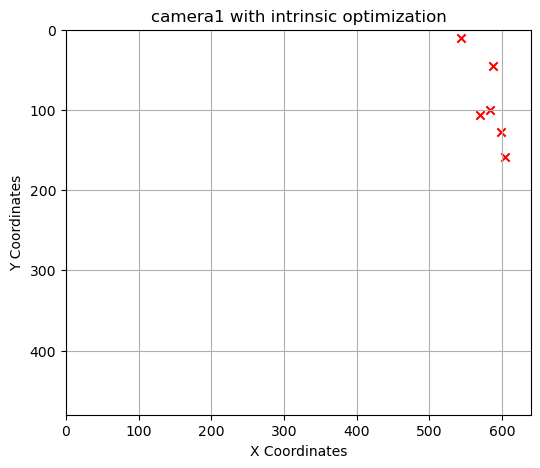

In [26]:
plot_points(normalized_projected_points_2dim.cpu().detach().numpy(), "camera1 with intrinsic optimization")

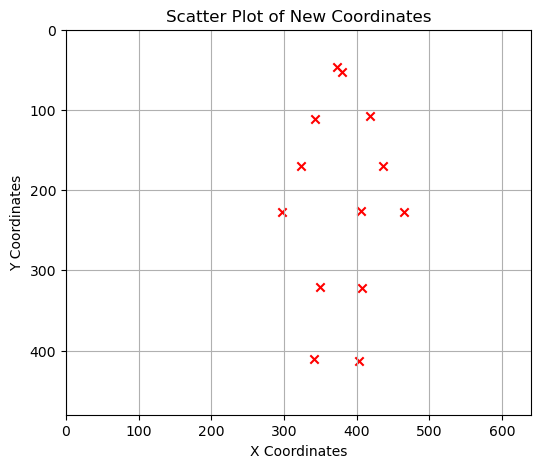

In [27]:
plot_points(points2d_1.cpu())

# Optimization of Intrinsic Parameters & Joint Optimization

In [28]:
choice = 0

X1_homogeneous = X1_homogeneous_all[choice]
X2_homogeneous = X2_homogeneous_all[choice]
points2d_1 = points2d_1_all[choice]
points2d_2 = points2d_2_all[choice]
K1 = construct_K_matrix(K1_params)
K2 = construct_K_matrix(K2_params)
P1 = K1 @ R_t_1.reshape(3,4)
P2 = K2 @ R_t_2.reshape(3,4)
triangulation = triangulate_points(X1_homogeneous, X2_homogeneous, P1, P2)

In [29]:
def optimize_parameters(K_params, R_t, X_3d, x_2d, optimize_intrinsic=True, num_iterations=250, lr=1e-2):
    K_params = K_params.clone().detach().requires_grad_(optimize_intrinsic)
    R_t = R_t.clone().detach().requires_grad_(not optimize_intrinsic)
    X_3d = X_3d.clone().detach()
    x_2d = x_2d.clone().detach()
    
    if optimize_intrinsic:
        optimizer = torch.optim.Adam(params=[K_params], lr=lr)
    else:
        optimizer = torch.optim.Adam(params=[R_t], lr=lr)

    
    for epoch in range(num_iterations):
        # print(f"Epoch: {epoch} \n-----")
        
        loss = loss_function(K_params, R_t, X_3d, x_2d)

        optimizer.zero_grad()

        loss.backward()

        optimizer.step()

    return K_params.detach() if optimize_intrinsic else R_t.detach()

## Main Loop for intrinsic optimization

In [30]:
K1_optimized_params = optimize_parameters(K1_params, R_t_2, triangulation, points2d_1, optimize_intrinsic=True, num_iterations=250)

print(K1_optimized_params)

error: 170.0561065673828
error: 158.2867431640625
error: 180.21053059895834
error: 166.9607696533203
error: 207.418505859375
error: 189.4721476236979
error: 238.95790318080358
error: 216.67990112304688
error: 235.30604383680554
error: 233.0737060546875
error: 261.35586825284093
error: 269.0928955078125
error: 283.78016075721155
error: 170.050048828125
error: 158.28012084960938
error: 180.20524088541666
error: 166.954833984375
error: 207.41259765625
error: 189.46573893229166
error: 238.95148577008928
error: 216.67286682128906
error: 235.29912651909723
error: 233.0669189453125
error: 261.34916548295456
error: 269.0863444010417
error: 283.77388822115387
error: 170.04400634765625
error: 158.27349853515625
error: 180.1999715169271
error: 166.94891357421875
error: 207.406689453125
error: 189.45930989583334
error: 238.945068359375
error: 216.6658172607422
error: 235.29218207465277
error: 233.0601318359375
error: 261.34248490767044
error: 269.0797932942708
error: 283.76761568509613
error: 170.

In [31]:
K2_optimized_params = optimize_parameters(K2_params, R_t_2, triangulation, points2d_2, optimize_intrinsic=True, num_iterations=250)
print(K2_optimized_params)

error: 261.7745056152344
error: 247.43951416015625
error: 275.3932291666667
error: 260.30596923828125
error: 300.053369140625
error: 281.72471110026044
error: 331.23793247767856
error: 308.14495849609375
error: 325.0429416232639
error: 320.7138916015625
error: 346.40305397727275
error: 351.0690104166667
error: 361.34067007211536
error: 261.7684631347656
error: 247.4329071044922
error: 275.3879801432292
error: 260.300048828125
error: 300.0474853515625
error: 281.71832275390625
error: 331.23154994419644
error: 308.137939453125
error: 325.03602430555554
error: 320.7071044921875
error: 346.3963512073864
error: 351.0624186197917
error: 361.33435997596155
error: 261.762451171875
error: 247.42633056640625
error: 275.3827311197917
error: 260.2941589355469
error: 300.0416259765625
error: 281.7119547526042
error: 331.2251674107143
error: 308.13092041015625
error: 325.0291341145833
error: 320.7003662109375
error: 346.3897150213068
error: 351.055908203125
error: 361.328125
error: 261.7564086914062

## Joint optimization function
- extrinsic opt --> intrinsic opt --> triangulation --> repeat!

In [32]:
def joint_optimization(K1_params, K2_params, R_t_1, R_t_2, triangulated_point, X1_homogeneous, X2_homogeneous, points2d_1, points2d_2):
    # Optimize extrinsic parameters
    R_t_2_opt = torch.tensor(optimize_parameters(K1_params, R_t_2, triangulated_point, points2d_1, optimize_intrinsic=False), device = device)
    # print("\n-----------------------------------------------------------------------------")
    R_t_2_opt = torch.tensor(optimize_parameters(K2_params, R_t_2_opt, triangulated_point, points2d_2, optimize_intrinsic=False), device = device)
    # Optimize intrinsic parameters
    K1_optimized_params = torch.tensor(optimize_parameters(K1_params, R_t_2_opt, triangulated_point, points2d_1, optimize_intrinsic=True), device = device)
    # print("\n-----------------------------------------------------------------------------")
    K2_optimized_params = torch.tensor(optimize_parameters(K2_params, R_t_2_opt, triangulated_point, points2d_2, optimize_intrinsic=True), device = device)

    # Reconstruct final K matrices
    K1_final = construct_K_matrix(K1_optimized_params)
    K2_final = construct_K_matrix(K2_optimized_params)

    # Final triangulation
    P1_final = K1_final @ R_t_1.reshape(3, 4)
    P2_final = K2_final @ R_t_2_opt.reshape(3, 4)
    
    X_3D_final = triangulate_points(X1_homogeneous, X2_homogeneous, P1_final, P2_final)

    return K1_optimized_params, K2_optimized_params, R_t_1, R_t_2_opt, X_3D_final

## Main loop for joint optimization

In [33]:
K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final = joint_optimization(
    K1_optimized_params, K2_optimized_params, R_t_1, R_t_2, triangulation, X1_homogeneous, X2_homogeneous, points2d_1, points2d_2
)

for i in range(10):
    K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final = joint_optimization(
    K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final, X1_homogeneous, X2_homogeneous, points2d_1, points2d_2
)

print("final")
print("\n---------------------------------------------------------------------")
print(f"K1_final :\n{K1_final}")
print(f"K2_final :\n{K2_final}")
print(f"R_t_1_final :\n{R_t_1_final}")
print(f"R_t_2_final :\n{R_t_2_final}")
print(f"X_3D_final :\n{X_3D_final}")
print("---------------------------------------------------------------------\n")

error: 168.54856872558594
error: 156.63604736328125
error: 178.8936767578125
error: 165.48196411132812
error: 205.94833984375
error: 187.87506103515625
error: 237.36080496651786
error: 214.9258270263672
error: 233.58124457465277
error: 231.38447265625
error: 259.68989701704544
error: 267.4617919921875
error: 282.2177170973558
error: 160.96340942382812
error: 149.021728515625
error: 171.51814778645834
error: 158.06268310546875
error: 194.70845947265624
error: 177.27435302734375
error: 224.56495884486608
error: 202.80787658691406
error: 219.95952690972223
error: 216.67861328125
error: 244.1421786221591
error: 251.2845458984375
error: 265.58755258413464
error: 153.37826538085938
error: 141.40740966796875
error: 164.14260864257812
error: 150.64337158203125
error: 183.4685791015625
error: 166.67365519205728
error: 211.76913016183036
error: 190.68995666503906
error: 206.33786349826389
error: 201.97279052734376
error: 228.59452681107953
error: 235.10736083984375
error: 248.9574256310096
error

C:\Users\jack2\AppData\Local\Temp\ipykernel_14452\4152691471.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  R_t_2_opt = torch.tensor(optimize_parameters(K1_params, R_t_2, triangulated_point, points2d_1, optimize_intrinsic=False), device = device)


error: 10.255790710449219
error: 8.12396240234375
error: 13.511151631673178
error: 11.715898513793945
error: 16.761863708496094
error: 16.022713979085285
error: 20.84151349748884
error: 20.985563278198242
error: 21.084004720052082
error: 20.686978149414063
error: 20.36964971368963
error: 20.766234079996746
error: 21.116365872896633
error: 7.898830413818359
error: 5.240898132324219
error: 10.741663614908854
error: 10.193229675292969
error: 15.021290588378907
error: 15.087257385253906
error: 19.672271728515625
error: 20.334060668945312
error: 20.828123304578995
error: 20.752662658691406
error: 20.686355590820312
error: 21.21871058146159
error: 21.651263897235577
error: 5.463329315185547
error: 3.9142704010009766
error: 8.98099136352539
error: 9.44580364227295
error: 13.88314208984375
error: 14.246546427408854
error: 18.572025844029017
error: 19.452817916870117
error: 20.093331231011284
error: 20.223617553710938
error: 20.256548794833098
error: 20.991785685221355
error: 21.561607947716347

C:\Users\jack2\AppData\Local\Temp\ipykernel_14452\4152691471.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  R_t_2_opt = torch.tensor(optimize_parameters(K2_params, R_t_2_opt, triangulated_point, points2d_2, optimize_intrinsic=False), device = device)


error: 96.12168884277344
error: 94.06730651855469
error: 101.39747111002605
error: 100.48512268066406
error: 105.55643310546876
error: 104.05788167317708
error: 105.79141671316964
error: 101.06717681884766
error: 105.44550916883681
error: 107.4031005859375
error: 108.51939808238636
error: 107.95676676432292
error: 103.18206317608173
error: 96.10823059082031
error: 94.05424499511719
error: 101.38389078776042
error: 100.471923828125
error: 105.54296875
error: 104.0448506673177
error: 105.77834647042411
error: 101.0546646118164
error: 105.43292914496527
error: 107.390625
error: 108.50722434303977
error: 107.9449462890625
error: 103.17086087740384
error: 96.09480285644531
error: 94.04118347167969
error: 101.3703104654948
error: 100.45872497558594
error: 105.5295166015625
error: 104.03182983398438
error: 105.76527622767857
error: 101.04215240478516
error: 105.42034233940973
error: 107.3781494140625
error: 108.49505060369319
error: 107.93311564127605
error: 103.15965857872597
error: 96.08131

C:\Users\jack2\AppData\Local\Temp\ipykernel_14452\4152691471.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  K1_optimized_params = torch.tensor(optimize_parameters(K1_params, R_t_2_opt, triangulated_point, points2d_1, optimize_intrinsic=True), device = device)


error: 3.1851895650227866
error: 3.559292793273926
error: 5.416948699951172
error: 4.70073127746582
error: 7.795505523681641
error: 9.5009765625
error: 10.826997545030382
error: 11.481268310546875
error: 11.837330211292613
error: 11.840686798095703
error: 11.346266526442308
error: 1.8440132141113281
error: 2.263936996459961
error: 3.1748441060384116
error: 3.554537773132324
error: 5.410259246826172
error: 4.695731480916341
error: 7.789325714111328
error: 9.49449348449707
error: 10.822696261935764
error: 11.478546142578125
error: 11.83568642356179
error: 11.839845021565756
error: 11.345205453725962
error: 1.8305549621582031
error: 2.2556819915771484
error: 3.164470672607422
error: 3.549771308898926
error: 5.4035484313964846
error: 4.690732955932617
error: 7.783133915492466
error: 9.487997055053711
error: 10.81838650173611
error: 11.475819396972657
error: 11.834048184481533
error: 11.839012145996094
error: 11.344149076021635
error: 1.8170356750488281
error: 2.2473697662353516
error: 3.15

C:\Users\jack2\AppData\Local\Temp\ipykernel_14452\4152691471.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  K2_optimized_params = torch.tensor(optimize_parameters(K2_params, R_t_2_opt, triangulated_point, points2d_2, optimize_intrinsic=True), device = device)


error: 4.094932556152344
error: 11.79034423828125
error: 19.730178833007812
error: 25.23458480834961
error: 29.29277648925781
error: 34.78103383382162
error: 37.743905203683035
error: 44.000125885009766
error: 40.340542263454864
error: 38.9822265625
error: 36.19487415660512
error: 36.68475850423177
error: 38.18500460111178
error: 12.426170349121094
error: 10.975067138671875
error: 21.48267110188802
error: 24.145160675048828
error: 29.515274047851562
error: 33.456128438313804
error: 37.224278041294646
error: 42.52219009399414
error: 39.55927870008681
error: 37.708282470703125
error: 34.72383256392045
error: 35.04670715332031
error: 36.50549081655649
error: 22.910850524902344
error: 13.30047607421875
error: 25.647878011067707
error: 24.548263549804688
error: 31.08190002441406
error: 33.06051890055338
error: 37.58534458705357
error: 41.69121551513672
error: 39.422885470920136
error: 36.94244384765625
error: 33.85697243430398
error: 33.92699432373047
error: 35.28450364332933
error: 32.7572

x_2d_cam1:
 tensor([[460.5181, 107.2632,   1.6272],
        [429.0891, 116.1683,   1.6198],
        [399.4379, 162.0580,   1.2787],
        [350.2670, 175.6682,   1.4092],
        [366.4833, 207.0454,   1.1030],
        [289.5179, 233.5977,   1.2557],
        [351.9757, 237.6454,   0.9823],
        [234.0942, 282.1888,   1.1474],
        [295.3126, 232.7279,   0.9437],
        [269.1848, 248.8914,   1.0104],
        [257.6013, 282.5447,   0.8202],
        [225.5988, 292.5267,   0.8414],
        [197.3695, 328.3679,   0.7350]], device='cuda:0')

normalized
 tensor([[283.0097,  65.9182,   1.0000],
        [264.9104,  71.7198,   1.0000],
        [312.3794, 126.7370,   1.0000],
        [248.5563, 124.6576,   1.0000],
        [332.2702, 187.7166,   1.0000],
        [230.5564, 186.0246,   1.0000],
        [358.3300, 241.9357,   1.0000],
        [204.0183, 245.9339,   1.0000],
        [312.9167, 246.6012,   1.0000],
        [266.4055, 246.3218,   1.0000],
        [314.0636, 344.4743,   1.0000

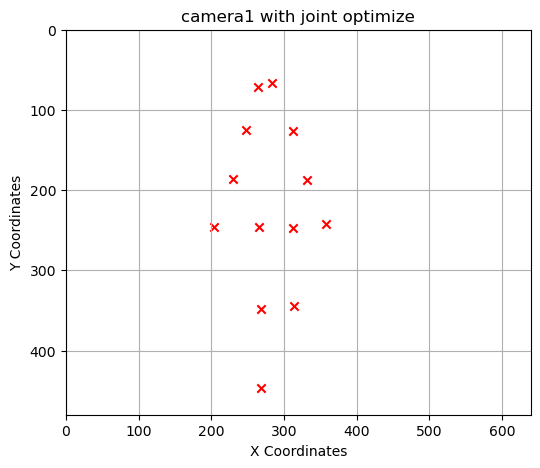

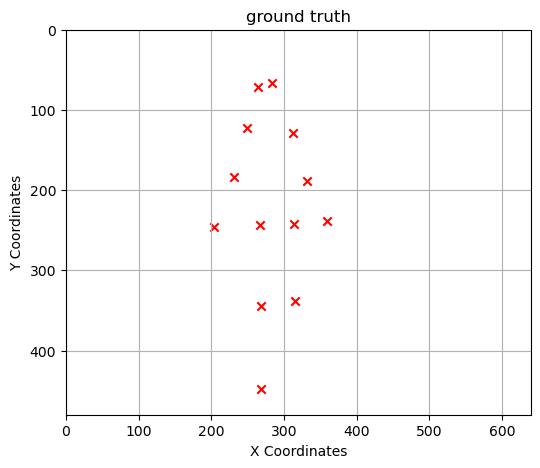

x_2d_cam2:
 tensor([[702.0984, 122.0467,   1.6252],
        [664.3472, 131.5112,   1.6202],
        [586.3459, 160.8750,   1.2808],
        [550.1367, 180.3654,   1.4098],
        [530.6246, 195.4533,   1.1013],
        [467.2463, 228.6563,   1.2518],
        [502.4186, 218.4029,   0.9767],
        [395.4285, 270.1733,   1.1396],
        [423.8616, 216.6439,   0.9510],
        [406.9387, 234.5513,   1.0138],
        [372.1065, 257.4942,   0.8208],
        [338.5970, 268.9183,   0.8431],
        [297.1563, 297.7698,   0.7326]], device='cuda:0')

normalized
 tensor([[431.9965,  75.0946,   1.0000],
        [410.0336,  81.1684,   1.0000],
        [457.7986, 125.6056,   1.0000],
        [390.2193, 127.9356,   1.0000],
        [481.8364, 177.4824,   1.0000],
        [373.2671, 182.6657,   1.0000],
        [514.4274, 223.6232,   1.0000],
        [346.9875, 237.0765,   1.0000],
        [445.6815, 227.7964,   1.0000],
        [401.3864, 231.3511,   1.0000],
        [453.3535, 313.7163,   1.0000

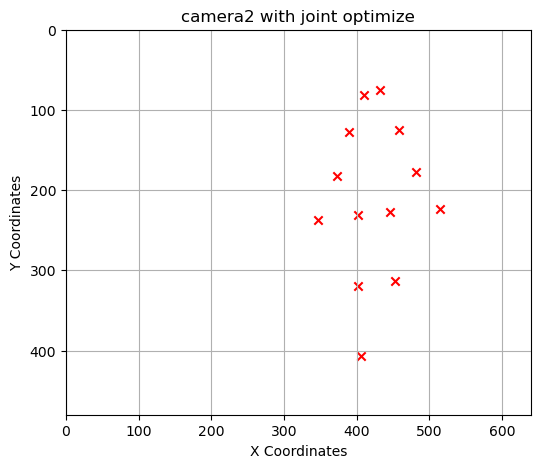

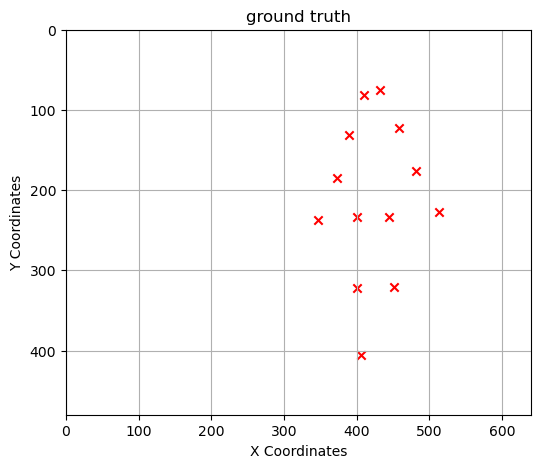

(None, None)

In [34]:
# For Camera 1
x_2d_cam1 = project_points(K1_final, R_t_1_final, X_3D_final)

print("x_2d_cam1:\n",x_2d_cam1)

normalized_cam1, normalized_2d_cam1 = normalize_points(x_2d_cam1)

print("\nnormalized\n", normalized_cam1, "\nnormalized_2d\n", normalized_2d_cam1)

plot_points(normalized_2d_cam1.detach().cpu(), "camera1 with joint optimize"), plot_points(points2d_1.detach().cpu(), "ground truth")

# For camera 2
x_2d_cam2 = project_points(K2_final, R_t_2_final, X_3D_final)

print("x_2d_cam2:\n",x_2d_cam2)

normalized_cam2, normalized_2d_cam2 = normalize_points(x_2d_cam2)

print("\nnormalized\n", normalized_cam2, "\nnormalized_2d\n", normalized_2d_cam2)

plot_points(normalized_2d_cam2.detach().cpu(), "camera2 with joint optimize"), plot_points(points2d_2.detach().cpu(), "ground truth")

## Reprojection Error

In [35]:
def reproject_error(K, R_t, points2d, X_3D_final):
    X_2d_final = project_points(K, R_t, X_3D_final)
    
    # Assuming normalize_points is adjusted for tensors
    _, normalized_2d = normalize_points(X_2d_final)

    errors = torch.sqrt(torch.sum((normalized_2d[:, :2] - points2d[:, :2])**2, dim = 1))

    average_error = torch.mean(errors)
    
    # error_total = 0



    # for i, reproject_point in enumerate(normalized_2d):
    #     error = torch.sqrt(
    #         (reproject_point[0] - points2d[i][0])**2 + 
    #         (reproject_point[1] - points2d[i][1])**2
    #     )
    #     error_total += error

    # average_error = error_total / (i + 1)
    return average_error

# Sample data - assuming K1_final, R_t_1_final, points2d_1, and X_3D_final are tensors
# Error_1 = reproject_error(K1_final, R_t_1_final, points2d_1, X_3D_final)
# Error_2 = reproject_error(K2_final, R_t_2_final, points2d_2, X_3D_final)

# print(f"Reprojection error for camera1: {Error_1.item()}")
# print(f"Reprojection error for camera2: {Error_2.item()}")




## Optimize with all pairs of images

In [36]:
def optimize_and_visualize_camera(choice, K1_final_func, K2_final_func, R_t_1_final_func, R_t_2_final_func, X_3D_final_func):

    X1_homogeneous = X1_homogeneous_all[choice]
    X2_homogeneous = X2_homogeneous_all[choice]

    points2d_1 = points2d_1_all[choice]
    points2d_2 = points2d_2_all[choice]

    K1 = construct_K_matrix(K1_final_func)
    K2 = construct_K_matrix(K2_final_func)

    P1 = K1 @ R_t_1_final_func.reshape(3,4)
    P2 = K2 @ R_t_2_final_func.reshape(3,4)

    # triangulation = triangulate_points(X1_homogeneous, X2_homogeneous, P1, P2)

    # Intrinsic optimization
    K1_optimized_params = optimize_parameters(K1_final_func, R_t_2_final_func, X_3D_final_func, points2d_1, optimize_intrinsic=True, num_iterations=250)
    print(K1_optimized_params)

    K2_optimized_params = optimize_parameters(K2_final_func, R_t_2_final_func, X_3D_final_func, points2d_2, optimize_intrinsic=True, num_iterations=250)
    print(K2_optimized_params)

    # Joint optimization
    K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final = joint_optimization(
        K1_optimized_params, K2_optimized_params, R_t_1_final_func, R_t_2_final_func, X_3D_final_func, X1_homogeneous, X2_homogeneous, points2d_1, points2d_2
    )

    for _ in range(10):
        K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final = joint_optimization(
        K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final, X1_homogeneous, X2_homogeneous, points2d_1, points2d_2
    )

    # Visualize results
    x_2d_cam1 = project_points(K1_final, R_t_1_final, X_3D_final)
    _, normalized_2d_cam1 = normalize_points(x_2d_cam1)
    plot_points(normalized_2d_cam1.cpu().detach().numpy(), "Optimized Camera 1")
    plot_points(points2d_1.cpu().detach(), "Ground Truth Camera 1")

    x_2d_cam2 = project_points(K2_final, R_t_2_final, X_3D_final)
    _, normalized_2d_cam2 = normalize_points(x_2d_cam2)
    plot_points(normalized_2d_cam2.cpu().detach().numpy(), "Optimized Camera 2")
    plot_points(points2d_2.cpu().detach(), "Ground Truth Camera 2")


error: 299.63128662109375
error: 273.8835754394531
error: 276.07716878255206
error: 250.89134216308594
error: 258.4322265625
error: 231.09566243489584
error: 244.98435756138392
error: 222.822021484375
error: 219.54568142361111
error: 218.504931640625
error: 215.18894264914772
error: 211.65458170572916
error: 206.18267352764423
error: 299.638916015625
error: 273.86553955078125
error: 276.0661214192708
error: 250.87432861328125
error: 258.4128662109375
error: 231.0748291015625
error: 244.96292550223214
error: 222.80044555664062
error: 219.5240478515625
error: 218.483251953125
error: 215.16768022017047
error: 211.6337687174479
error: 206.16256009615384
error: 299.64691162109375
error: 273.8477478027344
error: 276.0552571614583
error: 250.85748291015625
error: 258.3936767578125
error: 231.0541788736979
error: 244.94166782924108
error: 222.77903747558594
error: 219.50257703993054
error: 218.4617431640625
error: 215.14659534801137
error: 211.61311848958334
error: 206.14259690504807
error: 29

C:\Users\jack2\AppData\Local\Temp\ipykernel_14452\4152691471.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  R_t_2_opt = torch.tensor(optimize_parameters(K1_params, R_t_2, triangulated_point, points2d_1, optimize_intrinsic=False), device = device)


error: 150.8559112548828
error: 106.241455078125
error: 82.23563639322917
error: 74.65925598144531
error: 63.465966796875
error: 61.36552937825521
error: 56.02093505859375
error: 79.13700866699219
error: 70.97608778211806
error: 72.430712890625
error: 65.99927867542614
error: 65.40438334147136
error: 66.13784555288461
error: 154.0349884033203
error: 114.73065185546875
error: 88.77618408203125
error: 82.64601135253906
error: 71.6532470703125
error: 68.49280802408855
error: 62.73826381138393
error: 85.18447875976562
error: 75.98961724175348
error: 77.84029541015624
error: 71.55982555042614
error: 71.13381958007812
error: 71.5011455829327
error: 150.8189239501953
error: 116.78350830078125
error: 89.98458862304688
error: 85.19352722167969
error: 74.63374633789063
error: 71.18668619791667
error: 65.6295645577567
error: 87.33859252929688
error: 78.37929958767361
error: 80.46796264648438
error: 74.2876309481534
error: 73.97073872884114
error: 74.02353140024039
error: 147.20884704589844
error:

C:\Users\jack2\AppData\Local\Temp\ipykernel_14452\4152691471.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  R_t_2_opt = torch.tensor(optimize_parameters(K2_params, R_t_2_opt, triangulated_point, points2d_2, optimize_intrinsic=False), device = device)


error: 355.55914306640625
error: 304.7957458496094
error: 278.8408203125
error: 266.9136657714844
error: 248.9263671875
error: 240.36857096354166
error: 231.49724469866072
error: 245.26028442382812
error: 232.29269748263889
error: 231.5243408203125
error: 222.27712180397728
error: 219.75056966145834
error: 215.64601487379807
error: 355.5477294921875
error: 304.77606201171875
error: 278.82566324869794
error: 266.8953552246094
error: 248.9110595703125
error: 240.35111490885416
error: 231.47978864397322
error: 245.2444610595703
error: 232.27851019965277
error: 231.509326171875
error: 222.2617853338068
error: 219.7347615559896
error: 215.62982647235577
error: 355.536376953125
error: 304.7563781738281
error: 278.81056722005206
error: 266.87713623046875
error: 248.895849609375
error: 240.333740234375
error: 231.46238490513392
error: 245.22869873046875
error: 232.26437717013889
error: 231.494384765625
error: 222.2465154474432
error: 219.7190144856771
error: 215.61371319110577
error: 355.52508

C:\Users\jack2\AppData\Local\Temp\ipykernel_14452\4152691471.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  K1_optimized_params = torch.tensor(optimize_parameters(K1_params, R_t_2_opt, triangulated_point, points2d_1, optimize_intrinsic=True), device = device)


error: 114.63844299316406
error: 58.639381408691406
error: 46.655965169270836
error: 36.99047088623047
error: 29.891943359375
error: 25.005320231119793
error: 23.508071899414062
error: 43.381431579589844
error: 40.356360541449654
error: 43.08627014160156
error: 39.36247114701705
error: 40.68597412109375
error: 42.12452110877404
error: 114.66001892089844
error: 58.63892364501953
error: 46.66100056966146
error: 36.98890686035156
error: 29.8923828125
error: 25.003509521484375
error: 23.504791259765625
error: 43.38120651245117
error: 40.35542466905382
error: 43.08629455566406
error: 39.3613974831321
error: 40.683837890625
error: 42.12355393629808
error: 114.68135070800781
error: 58.638404846191406
error: 46.665995279947914
error: 36.98738479614258
error: 29.89285888671875
error: 25.001668294270832
error: 23.501482282366073
error: 43.38094711303711
error: 40.35443115234375
error: 43.08628540039062
error: 39.36028775301847
error: 40.68165842692057
error: 42.12254450871394
error: 114.70234680

C:\Users\jack2\AppData\Local\Temp\ipykernel_14452\4152691471.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  K2_optimized_params = torch.tensor(optimize_parameters(K2_params, R_t_2_opt, triangulated_point, points2d_2, optimize_intrinsic=True), device = device)


error: 26.3505859375
error: 46.828163146972656
error: 51.396036783854164
error: 66.26019287109375
error: 67.94962768554687
error: 82.94758605957031
error: 83.35968017578125
error: 78.83460998535156
error: 72.31321207682292
error: 69.721728515625
error: 64.28080610795455
error: 62.64920552571615
error: 58.92605356069711
error: 26.379638671875
error: 45.703369140625
error: 50.37926228841146
error: 64.82268524169922
error: 66.52410278320312
error: 81.21621195475261
error: 81.60201590401786
error: 77.15887451171875
error: 70.78609212239583
error: 68.27120971679688
error: 62.93159623579545
error: 61.3653818766276
error: 57.9388427734375
error: 28.66510009765625
error: 46.35792541503906
error: 50.14811706542969
error: 64.18376159667969
error: 65.58433837890625
error: 79.97579956054688
error: 80.20104108537946
error: 75.8563232421875
error: 69.53865559895833
error: 67.081787109375
error: 61.811767578125
error: 60.27704366048177
error: 57.09180157001202
error: 33.41644287109375
error: 47.73780

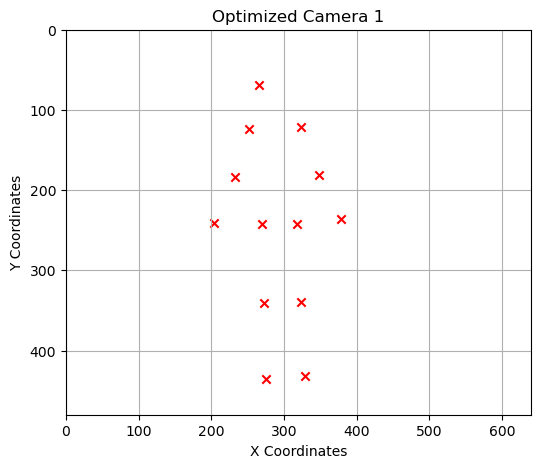

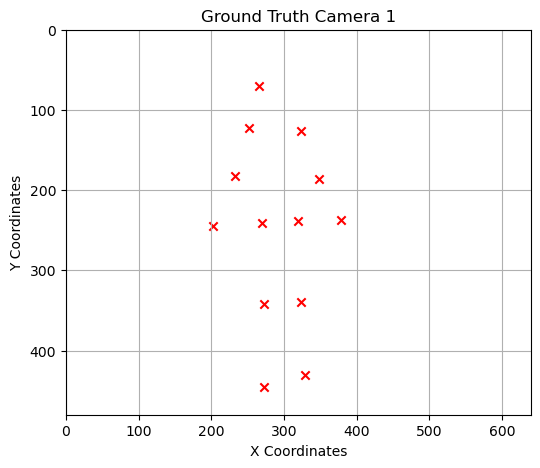

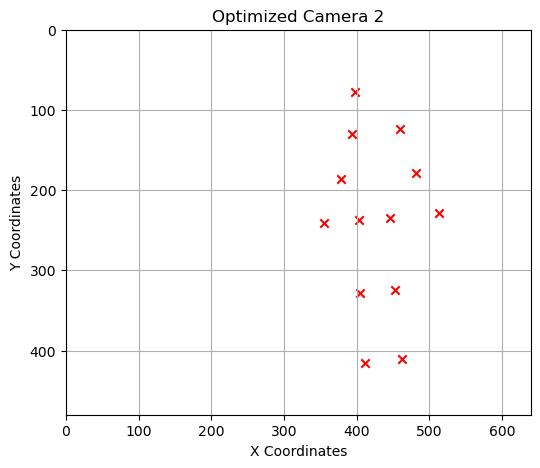

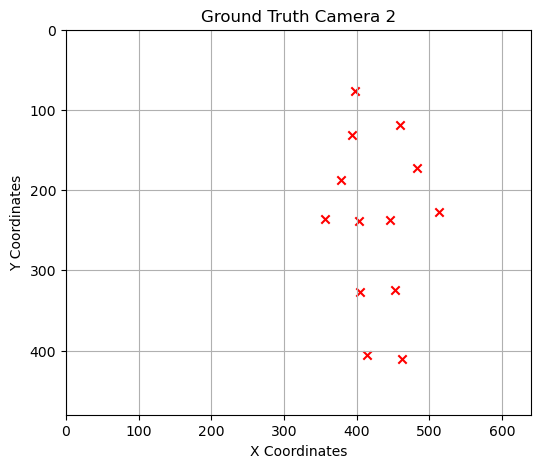

error: 271.96856689453125
error: 247.4464111328125
error: 274.64919026692706
error: 236.0297088623047
error: 250.770556640625
error: 216.972412109375
error: 229.40712193080358
error: 203.78347778320312
error: 209.43844943576389
error: 199.9103515625
error: 200.2980291193182
error: 201.58060709635416
error: 271.92315673828125
error: 247.40185546875
error: 274.6079508463542
error: 235.99005126953125
error: 250.733056640625
error: 216.93648274739584
error: 229.37276785714286
error: 203.7562255859375
error: 209.41414388020834
error: 199.88853759765624
error: 200.2779208096591
error: 201.56201171875
error: 271.8780822753906
error: 247.35752868652344
error: 274.56689453125
error: 235.95054626464844
error: 250.695751953125
error: 216.90071614583334
error: 229.33855329241072
error: 203.72909545898438
error: 209.38996039496527
error: 199.86683349609376
error: 200.2579012784091
error: 201.54349772135416
error: 271.8328552246094
error: 247.31304931640625
error: 274.52569580078125
error: 235.91091

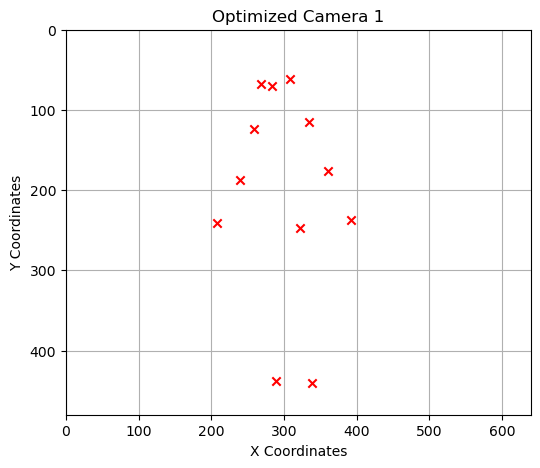

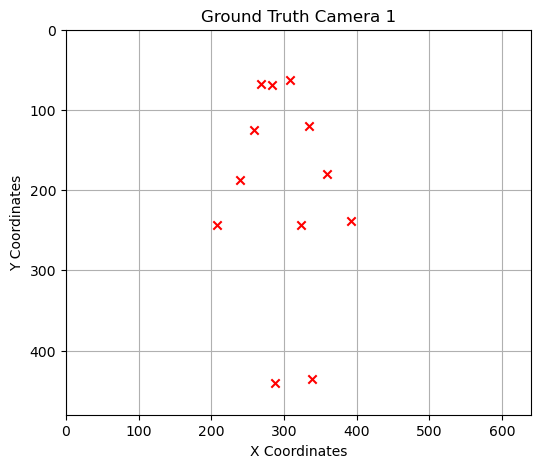

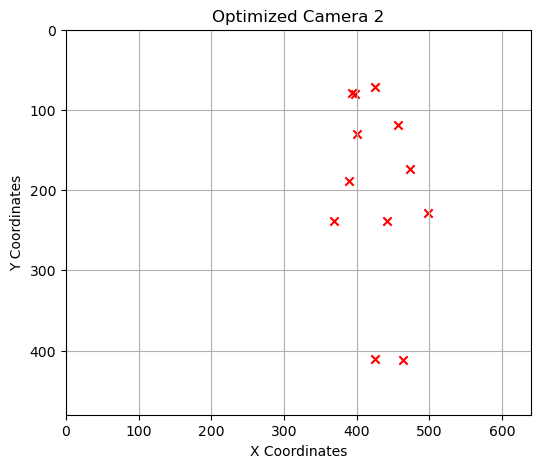

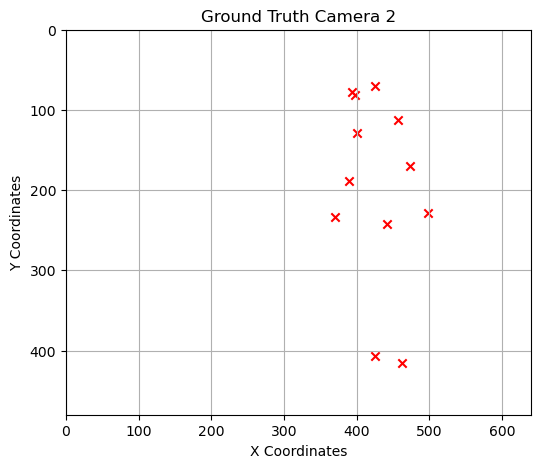

error: 223.15206909179688
error: 223.8480224609375
error: 199.2445068359375
error: 192.8636474609375
error: 177.19263916015626
error: 171.35416666666666
error: 159.39801897321428
error: 140.76260375976562
error: 141.1512451171875
error: 145.7269775390625
error: 144.03127219460228
error: 143.97256469726562
error: 223.10665893554688
error: 223.803466796875
error: 199.20328776041666
error: 192.82400512695312
error: 177.15517578125
error: 171.31827799479166
error: 159.36687360491072
error: 140.73565673828125
error: 141.12722439236111
error: 145.705419921875
error: 144.0113858309659
error: 143.95417277018228
error: 223.06158447265625
error: 223.7591552734375
error: 199.1622314453125
error: 192.7845001220703
error: 177.11785888671875
error: 171.28251139322916
error: 159.3358154296875
error: 140.7087860107422
error: 141.103271484375
error: 145.68392333984374
error: 143.99156605113637
error: 143.93584187825522
error: 223.016357421875
error: 223.71466064453125
error: 199.12101236979166
error: 1

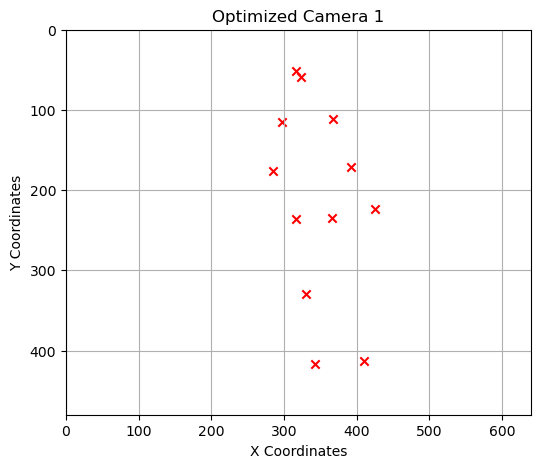

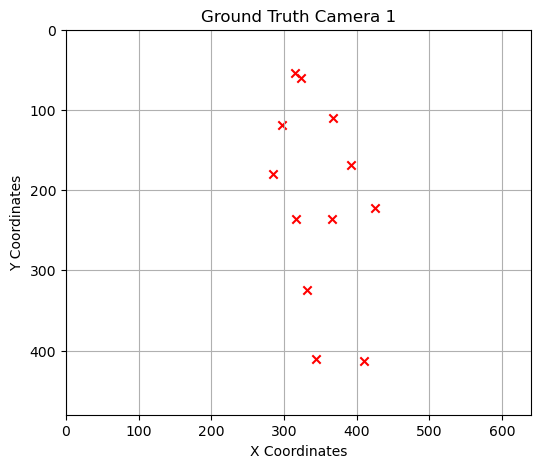

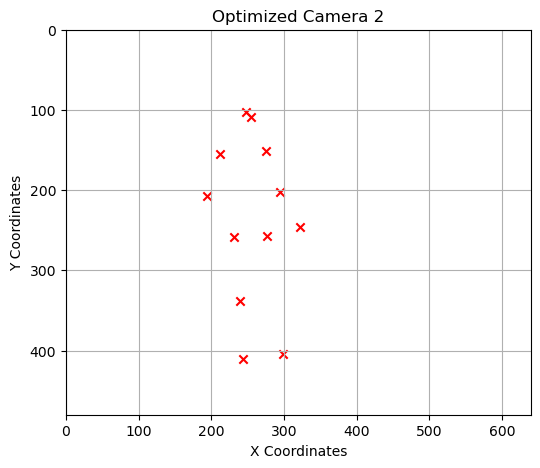

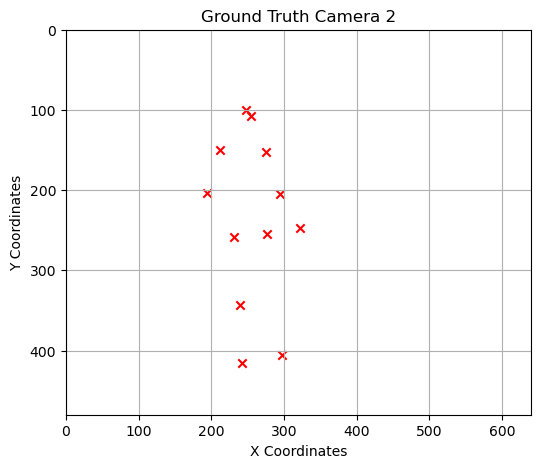

error: 219.89767456054688
error: 209.2628173828125
error: 234.70157877604166
error: 197.61376953125
error: 212.5376220703125
error: 180.50726318359375
error: 192.67864118303572
error: 178.06150817871094
error: 169.06282552083334
error: 163.2691650390625
error: 160.0532781427557
error: 158.6594034830729
error: 219.85226440429688
error: 209.21826171875
error: 234.66035970052084
error: 197.57412719726562
error: 212.500146484375
error: 180.47135416666666
error: 192.64430454799108
error: 178.03115844726562
error: 169.0357666015625
error: 163.244873046875
error: 160.0309170809659
error: 158.63874308268228
error: 219.80718994140625
error: 209.17391967773438
error: 234.61930338541666
error: 197.5346221923828
error: 212.462841796875
error: 180.43560791015625
error: 192.610107421875
error: 178.0009307861328
error: 169.00882975260416
error: 163.2206787109375
error: 160.0086337002841
error: 158.61815388997397
error: 219.761962890625
error: 209.12945556640625
error: 234.57808430989584
error: 197.49

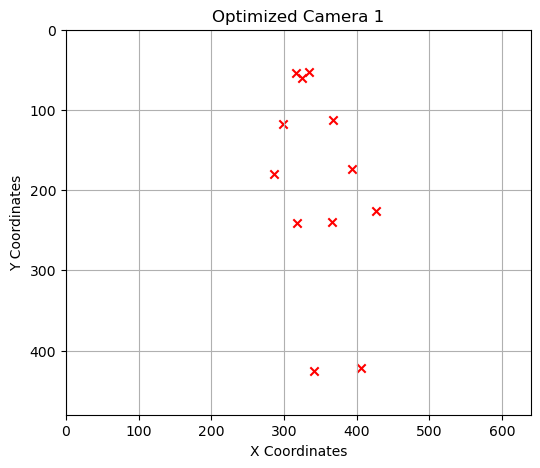

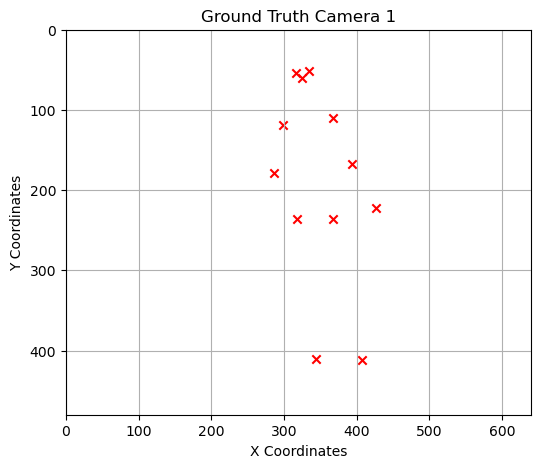

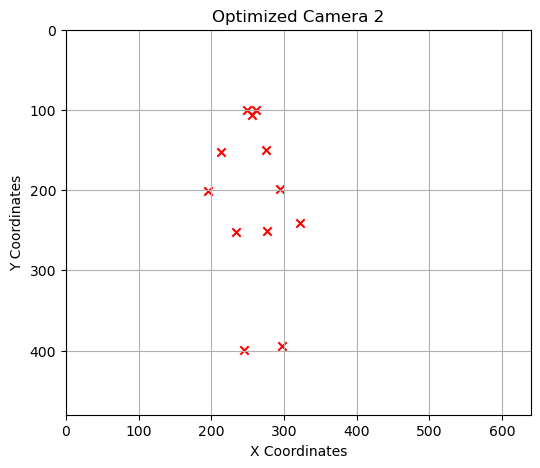

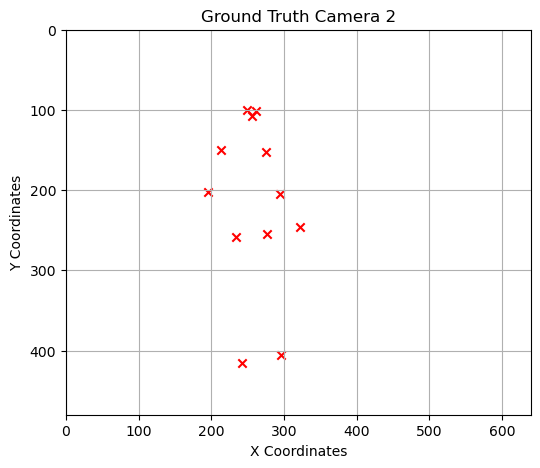

error: 143.41842651367188
error: 144.29730224609375
error: 125.75156656901042
error: 124.70879364013672
error: 112.74205322265625
error: 111.78525797526042
error: 103.28729248046875
error: 102.24057006835938
error: 96.92045762803819
error: 94.29439086914063
error: 94.73914683948864
error: 94.651123046875
error: 143.37301635742188
error: 144.25274658203125
error: 125.71034749348958
error: 124.66914367675781
error: 112.7045654296875
error: 111.74932861328125
error: 103.25611223493304
error: 102.21046447753906
error: 96.8912353515625
error: 94.2658935546875
error: 94.71295720880681
error: 94.626953125
error: 143.32794189453125
error: 144.2084197998047
error: 125.66929117838542
error: 124.629638671875
error: 112.6672607421875
error: 111.71358235677083
error: 103.22508021763393
error: 102.18051147460938
error: 96.86217583550348
error: 94.23753662109375
error: 94.68690074573864
error: 94.6029052734375
error: 143.28271484375
error: 144.1639404296875
error: 125.62809244791667
error: 124.590019

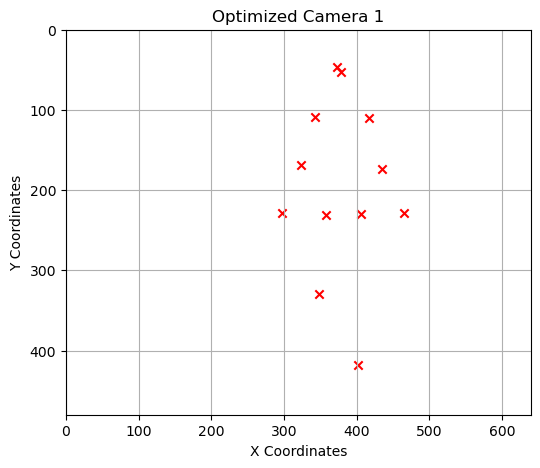

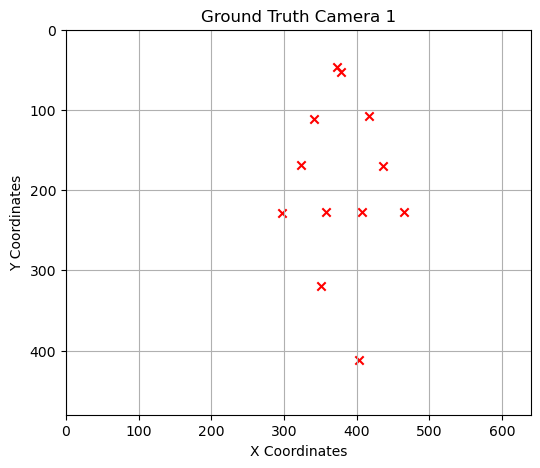

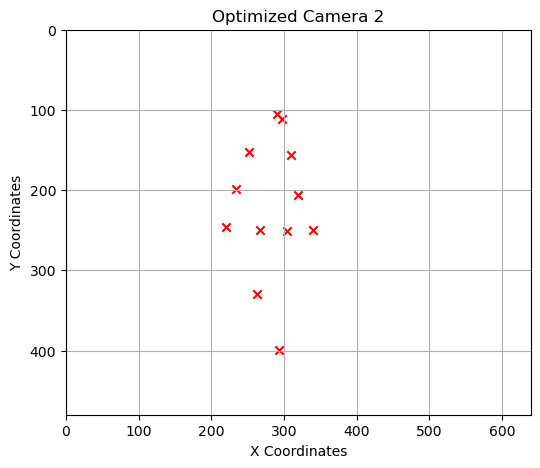

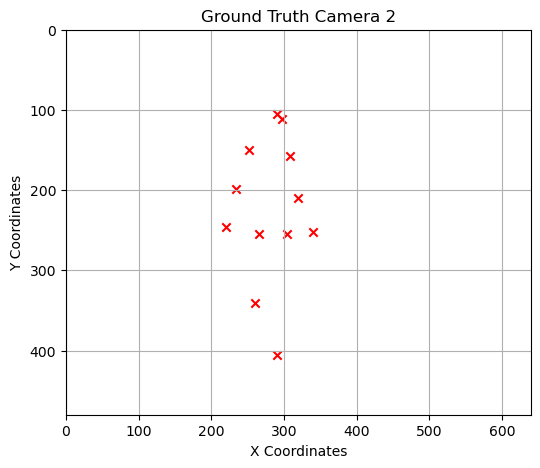

error: 141.79122924804688
error: 143.48370361328125
error: 124.78293863932292
error: 123.6300277709961
error: 111.87904052734375
error: 111.06608072916667
error: 102.67085484095982
error: 101.84461975097656
error: 96.77822536892361
error: 97.90989990234375
error: 98.17510431463069
error: 97.87086995442708
error: 95.2150127704327
error: 141.74581909179688
error: 143.43914794921875
error: 124.74171956380208
error: 123.59037780761719
error: 111.841552734375
error: 111.0301513671875
error: 102.63967459542411
error: 101.81451416015625
error: 96.74900309244792
error: 97.88365478515625
error: 98.1509676846591
error: 97.8485819498698
error: 95.1941387469952
error: 141.70074462890625
error: 143.3948211669922
error: 124.70066324869792
error: 123.55087280273438
error: 111.804248046875
error: 110.99440511067708
error: 102.608642578125
error: 101.78456115722656
error: 96.71994357638889
error: 97.85755615234375
error: 98.126953125
error: 97.82640584309895
error: 95.17336801382211
error: 141.65551757

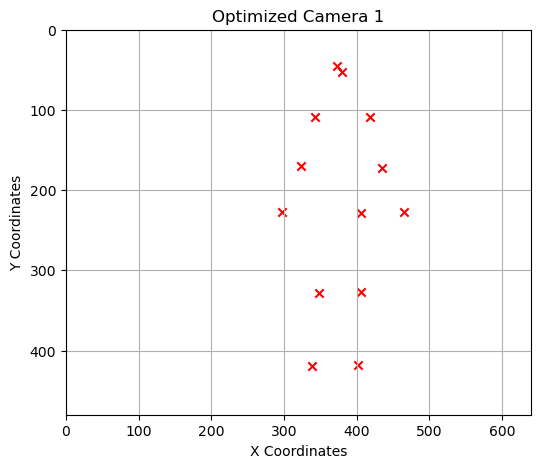

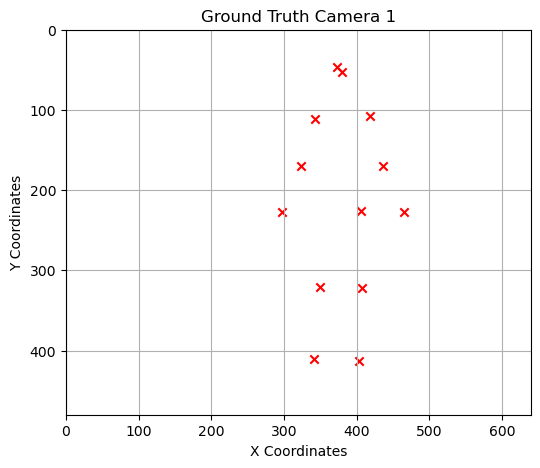

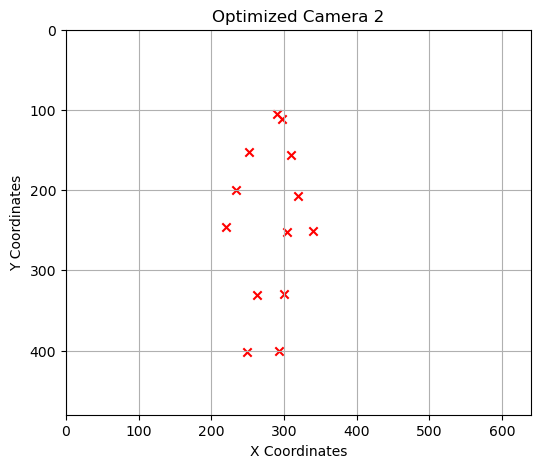

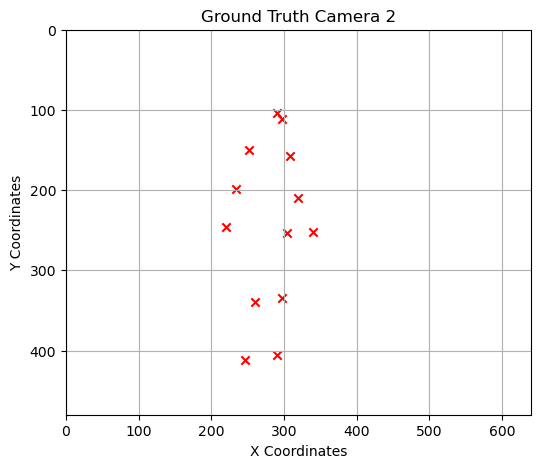

In [37]:
for choice in range(1,image_num):
    optimize_and_visualize_camera(choice, K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final)

In [38]:
K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final

(tensor([264.6609, 303.6626, 407.7704, 264.4574], device='cuda:0'),
 tensor([315.6135, 301.0122, 384.3765, 264.8146], device='cuda:0'),
 tensor([1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 1., 0.], device='cuda:0'),
 tensor([ 1.1032,  0.4287,  1.4132, -0.7521, -0.0191,  0.9593,  0.0758, -0.1417,
         -0.0452, -0.1091,  0.7972,  0.1774], device='cuda:0'),
 tensor([[-0.7671, -1.0639,  1.6272,  1.0000],
         [-0.8743, -1.0281,  1.6198,  1.0000],
         [-0.4609, -0.5799,  1.2787,  1.0000],
         [-0.8477, -0.6488,  1.4092,  1.0000],
         [-0.3146, -0.2787,  1.1030,  1.0000],
         [-0.8408, -0.3243,  1.2557,  1.0000],
         [-0.1835, -0.0729,  0.9823,  1.0000],
         [-0.8834, -0.0700,  1.1474,  1.0000],
         [-0.3382, -0.0555,  0.9437,  1.0000],
         [-0.5397, -0.0603,  1.0104,  1.0000],
         [-0.2904,  0.2161,  0.8202,  1.0000],
         [-0.4440,  0.2305,  0.8414,  1.0000],
         [-0.3867,  0.4413,  0.7350,  1.0000]], device='cuda:0'))

In [39]:
def reproject_error(K, R_t, points2d, X_3D_final):
    X_2d_final = project_points(K, R_t, X_3D_final)

# Assuming normalize_points is adjusted for tensors
    _, normalized_2d = normalize_points(X_2d_final)

    error_total = 0

    for i, reproject_point in enumerate(normalized_2d):
        error = torch.sqrt(
            (reproject_point[0] - points2d[i][0])**2 + 
            (reproject_point[1] - points2d[i][1])**2
        )
        error_total += error

    average_error = error_total / (i + 1)
    return average_error

#Sample data - assuming K1_final, R_t_1_final, points2d_1, and X_3D_final are tensors
Error_1 = reproject_error(K1_final, R_t_1_final, points2d_1, X_3D_final)
Error_2 = reproject_error(K2_final, R_t_2_final, points2d_2, X_3D_final)

print(f"Reprojection error for camera1: {Error_1.item()}")
print(f"Reprojection error for camera2: {Error_2.item()}")

Reprojection error for camera1: 2.330183506011963
Reprojection error for camera2: 2.6030054092407227


## Reconsruct to 3D

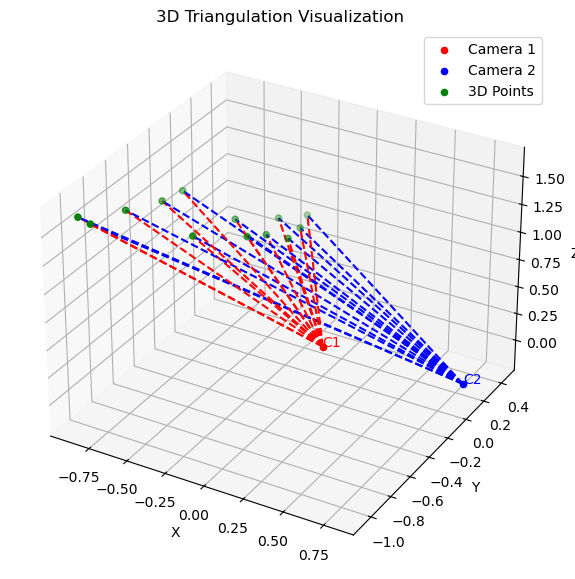

In [40]:
import torch
import matplotlib.pyplot as plt

def visualize_triangulation(X1, X2, P1, P2):
    """Visualizes the triangulation of 3D points from two cameras using PyTorch."""
    
    # Triangulate 3D points (ensure triangulate_points uses torch)
    X_3D = triangulate_points(X1, X2, P1, P2)  # Assuming this function returns a PyTorch tensor

    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')
    
    # Plot the first camera at origin (tensor must be detached and moved to CPU for plotting)
    ax.scatter(0, 0, 0, c='red', label='Camera 1')
    ax.text(0, 0, 0, "C1", color='red')
    
    # Plot the second camera (use torch.inverse for matrix inversion)
    C2 = -torch.inverse(P2[:, :3]).matmul(P2[:, 3])
    C2 = C2.cpu().detach().numpy()  # Convert to numpy for plotting
    ax.scatter(*C2, c='blue', label='Camera 2')
    ax.text(*C2, "C2", color='blue')

    # Plot the 3D points (convert tensors to numpy for plotting)
    X_3D_np = X_3D.cpu().detach().numpy()
    ax.scatter(X_3D_np[:, 0], X_3D_np[:, 1], X_3D_np[:, 2], c='green', label='3D Points')
    
    for i in range(X1.shape[0]):
        # Draw rays from camera 1 to 3D points
        ax.plot([0, X_3D_np[i, 0]], [0, X_3D_np[i, 1]], [0, X_3D_np[i, 2]], 'r--')
        
        # Draw rays from camera 2 to 3D points
        ax.plot([C2[0], X_3D_np[i, 0]], [C2[1], X_3D_np[i, 1]], [C2[2], X_3D_np[i, 2]], 'b--')
        
    # Setting up the plot
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.legend()
    ax.set_title("3D Triangulation Visualization")
    
    plt.show()

# # Example usage (make sure that `construct_K_matrix` and other functions return PyTorch tensors)
K1_new = construct_K_matrix(K1_final)  # Must return a PyTorch tensor
K2_new = construct_K_matrix(K2_final)  # Must return a PyTorch tensor
P1 = K1_new @ R_t_1_final.reshape(3, 4)  # Tensor reshaping and matrix multiplication in PyTorch
P2 = K2_new @ R_t_2_final.reshape(3, 4)  # Tensor reshaping and matrix multiplication in PyTorch
visualize_triangulation(X1_homogeneous, X2_homogeneous, P1, P2)


In [41]:
# def bigmainloop(num):
#     # Get the matches for the chosen image
#     match = matches_final[num]
#     print(f"Matches for image {num}:\n{match}\n")

#     # Calculate the fundamental matrix using the 8-point algorithm
#     F = compute_fundamental_matrix(match)
#     # print(f"F (Fundamental Matrix) = \n{F}")

#     # Calculate the essential matrix
#     E = compute_essential_matrix(F, K1, K2)  # K1 and K2 should be PyTorch tensors
#     # print(f"\nE (Essential Matrix) = \n{E}")
#     # 2D points from first and second camera
#     points2d_1 = []
#     points2d_2 = []

#     # Loop through match and ensure x1, y1, x2, y2 are converted to tensors
#     for x1, y1, x2, y2 in match:
#         points2d_1.append([float(x1), float(y1)])  # Ensure the values are floats
#         points2d_2.append([float(x2), float(y2)])

#     # Convert lists of points into PyTorch tensors
#     points2d_1 = torch.tensor(points2d_1, dtype = torch.float32).to(device)
#     points2d_2 = torch.tensor(points2d_2, dtype = torch.float32).to(device)

#     # Convert into homogeneous coordinates (add ones as the last column)
#     X1_homogeneous = torch.cat([points2d_1, torch.ones((points2d_1.shape[0], 1)).to(device)], dim=1)
#     X2_homogeneous = torch.cat([points2d_2, torch.ones((points2d_2.shape[0], 1)).to(device)], dim=1)

#     # Decompose the essential matrix
#     R1, R2, t1, t2 = decompose_essential_matrix(E)

#     best_R, best_t, best_triangulation = find_correct_solution(R1, R2, t1, t2, X1_homogeneous, X2_homogeneous, K1, K2)
#     if best_R == None:
#         print("couldn't find R and t!!")
#         return 0, 0, 0, 0, 0, 0
 
#     R_1 = torch.eye(3).to(device)
#     t_1 = torch.zeros(3).to(device)
#     R_t_1 = flatten_Rt(R_1, t_1)
#     # print(R_t_1)

#     # For camera2
#     R_2, t_2 = best_R,best_t
#     R_t_2 = flatten_Rt(R_2, t_2)
#     # print(R_t_2)

#     # # Calculate the losses
#     loss_1 = loss_function(K1_params, R_t_1, best_triangulation, points2d_1)
#     loss_2 = loss_function(K2_params, R_t_2, best_triangulation, points2d_2)

    

#     K1_optimized_params = torch.tensor(optimize_parameters(K1_params, R_t_1, best_triangulation, points2d_1, optimize_intrinsic= True), device = device)

#     K2_optimized_params = torch.tensor(optimize_parameters(K2_params, R_t_2, best_triangulation, points2d_2, optimize_intrinsic= True), device = device)
    
#     error_before = reproject_error(K1_optimized_params, R_t_1, points2d_1, best_triangulation)
#     error_before_2 = reproject_error(K2_optimized_params, R_t_2, points2d_2, best_triangulation)
#     print(f"Reprojection error before joint optimization for camera1: {error_before.item()}")
#     print(f"Reprojection error before joint optimization for camera1: {error_before_2.item()}")

#     # print(K2_optimized_params)  
#     K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final = joint_optimization(K1_optimized_params, K2_optimized_params, R_t_1, R_t_2, best_triangulation, X1_homogeneous, X2_homogeneous, points2d_1, points2d_2  )
#     epochs = 10
#     # Incursive
#     for epoch in range(epochs):
#         K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final= joint_optimization(K1_final, K2_final, R_t_1_final, R_t_2_final, X_3D_final, X1_homogeneous, X2_homogeneous, points2d_1, points2d_2)

#     #Sample data - assuming K1_final, R_t_1_final, points2d_1, and X_3D_final are tensors
#     Error_1 = reproject_error(K1_final, R_t_1_final, points2d_1, X_3D_final)
#     Error_2 = reproject_error(K2_final, R_t_2_final, points2d_2, X_3D_final)

#     print(f"Reprojection error for camera1: {Error_1.item()}")
#     print(f"Reprojection error for camera2: {Error_2.item()}")

#     print(f"Successfully calibrate image :{num}\n")
#     # # Example usage (make sure that `construct_K_matrix` and other functions return PyTorch tensors)
#     K1_new = construct_K_matrix(K1_final)  # Must return a PyTorch tensor
#     K2_new = construct_K_matrix(K2_final)  # Must return a PyTorch tensor
#     P1 = K1_new @ R_t_1_final.reshape(3, 4)  # Tensor reshaping and matrix multiplication in PyTorch
#     P2 = K2_new @ R_t_2_final.reshape(3, 4)  # Tensor reshaping and matrix multiplication in PyTorch
#     visualize_triangulation(X1_homogeneous, X2_homogeneous, P1, P2)

#     # For Camera 1
#     x_2d_cam1 = project_points(K1_final, R_t_1_final, X_3D_final)

#     print("x_2d_cam1:\n",x_2d_cam1)

#     normalized_cam1, normalized_2d_cam1 = normalize_points(x_2d_cam1)

#     print("\nnormalized\n", normalized_cam1, "\nnormalized_2d\n", normalized_2d_cam1)

#     plot_points(normalized_2d_cam1.detach().cpu(), "camera1 with joint optimize"), plot_points(points2d_1.detach().cpu(), "ground truth")

#     # For camera 2
#     x_2d_cam2 = project_points(K2_final, R_t_2_final, X_3D_final)

#     print("x_2d_cam2:\n",x_2d_cam2)

#     normalized_cam2, normalized_2d_cam2 = normalize_points(x_2d_cam2)

#     print("\nnormalized\n", normalized_cam2, "\nnormalized_2d\n", normalized_2d_cam2)

#     plot_points(normalized_2d_cam2.detach().cpu(), "camera2 with joint optimize"), plot_points(points2d_2.detach().cpu(), "ground truth")

#     return K1_final, K2_final, R_t_1_final, R_t_2_final, Error_1, Error_2


In [42]:
# K1_final_total, K2_final_total, R_t_1_final_total, R_t_2_final_total, Error_1_total, Error_2_total = bigmainloop(choice)



In [43]:
# K1_final_total = 0 
# K2_final_total = 0 
# Error_1_total = 0 
# Error_2_total = 0 
# R_t_1_final_total = 0 
# R_t_2_final_total = 0 

# counter = 0 # counting current image

# for i in range(1):
#     K1_final, K2_final, R_t_1_final, R_t_2_final, Error_1, Error_2 = bigmainloop(i)

#     if K1_final != None and Error_1 and Error_2 :
#         K1_final_total += K1_final
#         K2_final_total += K2_final
#         R_t_1_final_total += R_t_1_final
#         R_t_2_final_total += R_t_2_final
#         # X_3D_final_total += X_3D_final
#         Error_1_total += Error_1
#         Error_2_total += Error_2
#         counter += 1
#         # continue
#     # if K1_final == 0:
#     #     print("skip\n")
#     else:
#         print("skip\n")

# K1_final_total /= (counter)
# K2_final_total /= (counter)
# R_t_1_final_total /= (counter)
# R_t_2_final_total /= (counter)
# # X_3D_final_total /= (counter)
# Error_1_total /= (counter)
# Error_2_total /= (counter)


In [44]:
# print(f"K1_final_total : \n{K1_final_total}")
# print(f"K2_final_total : \n{K2_final_total}")
# print(f"R_t_1_final_total : \n{R_t_1_final_total}")
# print(f"R_t_2_final_total : \n{R_t_1_final_total}")

# print(f"Error_1_total : \n{Error_1_total}")
# print(f"Error_2_total : \n{Error_2_total}")

## Store K & R|t into txt file

In [45]:
from pathlib import Path
data_dir = Path("output")

# K file
f = open(f"{data_dir}/Final_K.txt", "w+")
input_k = "K= " + "\n" + str(construct_K_matrix(K1_final).cpu().numpy()) + "\n" + "K= " + "\n" + str(construct_K_matrix(K2_final).cpu().numpy()) 
f.write(input_k)
f.close()
# R file
f = open(f"{data_dir}/Final_R_t.txt", "w+")


R_t_1 = R_t_1_final.reshape(3, 4).cpu().numpy()
R_t_2 = R_t_2_final.reshape(3, 4).cpu().numpy()

def format_matrix(matrix):
    return "\n".join(
        "[ " + " ".join(f"{num:.10f}" for num in row) + " ]" for row in matrix
    )

input_Rt = (
    "R|t= " + "\n" + format_matrix(R_t_1) + "\n" +
    "R|t= " + "\n" + format_matrix(R_t_2)
)
f.write(input_Rt)
f.close()

In [46]:
# from pathlib import Path
# data_dir = Path("output")

# # K file
# f = open(f"{data_dir}/Final_K.txt", "w+")
# input_k = "K= " + "\n" + str(construct_K_matrix(K1_final_total).cpu().numpy()) + "\n" + "K= " + "\n" + str(construct_K_matrix(K2_final_total).cpu().numpy()) 
# f.write(input_k)
# f.close()


In [47]:
# # R file
# f = open(f"{data_dir}/Final_R_t.txt", "w+")


# R_t_1 = R_t_1_final_total.reshape(3, 4).cpu().numpy()
# R_t_2 = R_t_2_final_total.reshape(3, 4).cpu().numpy()

# def format_matrix(matrix):
#     return "\n".join(
#         "[ " + " ".join(f"{num:.10f}" for num in row) + " ]" for row in matrix
#     )

# input_Rt = (
#     "R|t= " + "\n" + format_matrix(R_t_1) + "\n" +
#     "R|t= " + "\n" + format_matrix(R_t_2)
# )
# f.write(input_Rt)
# f.close()
